# FIFA Player Overall Prediction

### Name : Sivajith P C
### Organization: Entri Elevate
### Date: 16-08-2024

## Table of Contents

### Overview
### Objective
### Data Collection
### Data Description
### EDA (Exploratory Data Analysis)
### Data Prepocessing
### Machine Learning Models
   #### Linear Regression
   #### Linear Regresion - Hyperparameter Tuning
   #### Random Forest Regressor
   #### Random Forest Regressor - Hyperparameter Tuning
   #### Support Vector Regression
   #### Support Vector Regression - Hyperparameter Tuning
   #### Gradient Boosting Regressor
   #### Gradient Boosting Regressor - Hyperparameter Tuning
   #### Adaboost
   #### Adaboost - Hyperparameter Tuning
   #### MLP Regressor
   #### MLP Regressor - Hyperparameter Tuning
### Result
### Limitations
### Conclusion
### Future Work

## Overview

This project aims to develop a machine learning model capable of accurately predicting a soccer player's overall FIFA rating based on their individual attributes. By analyzing and correlating various player characteristics such as pace, shooting, passing, dribbling, defending,physicality etc,  a model will be created that can effectively estimate a player's overall skill level. This model has potential applications in player scouting, valuation, and team formation strategies.

## Objective

To predict overall rating of FIFA players using the machine learning techniques.

## Data Collection

In [ ]:
# importing the libraries

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import math
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_selection import SelectKBest
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, r2_score,mean_absolute_error
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Ridge
from sklearn.feature_selection import mutual_info_regression

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
with open(r"C:\Users\Shivajith\Documents\Entri_ML_Datasets\FIFA\fifa.csv", 'r', encoding='utf-8', errors='ignore') as file:
    fifa = pd.read_csv(file)

fifa

,Unnamed: 0,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,...,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause
0,0,158023,L. Messi,31.0,https://cdn.sofifa.org/players/4/19/158023.png,Argentina,https://cdn.sofifa.org/flags/52.png,94.0,94,FC Barcelona,...,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226.5M
1,1,20801,Cristiano Ronaldo,33.0,https://cdn.sofifa.org/players/4/19/20801.png,Portugal,https://cdn.sofifa.org/flags/38.png,94.0,94,Juventus,...,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127.1M
2,2,190871,Neymar Jr,26.0,https://cdn.sofifa.org/players/4/19/190871.png,Brazil,https://cdn.sofifa.org/flags/54.png,92.0,93,Paris Saint-Germain,...,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228.1M
3,3,193080,De Gea,27.0,https://cdn.sofifa.org/players/4/19/193080.png,Spain,https://cdn.sofifa.org/flags/45.png,91.0,93,Manchester United,...,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138.6M
4,4,192985,K. De Bruyne,27.0,https://cdn.sofifa.org/players/4/19/192985.png,Belgium,https://cdn.sofifa.org/flags/7.png,91.0,92,Manchester City,...,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196.4M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18202,18202,238813,J. Lundstram,19.0,https://cdn.sofifa.org/players/4/19/238813.png,England,https://cdn.sofifa.org/flags/14.png,47.0,65,Crewe Alexandra,...,45.0,40.0,48.0,47.0,10.0,13.0,7.0,8.0,9.0,143K
18203,18203,243165,N. Christoffersson,19.0,https://cdn.sofifa.org/players/4/19/243165.png,Sweden,https://cdn.sofifa.org/flags/46.png,47.0,63,Trelleborgs FF,...,42.0,22.0,15.0,19.0,10.0,9.0,9.0,5.0,12.0,113K
18204,18204,241638,B. Worman,16.0,https://cdn.sofifa.org/players/4/19/241638.png,England,https://cdn.sofifa.org/flags/14.png,47.0,67,Cambridge United,...,41.0,32.0,13.0,11.0,6.0,5.0,10.0,6.0,13.0,165K
18205,18205,246268,D. Walker-Rice,17.0,https://cdn.sofifa.org/players/4/19/246268.png,England,https://cdn.sofifa.org/flags/14.png,47.0,66,Tranmere Rovers,...,46.0,20.0,25.0,27.0,14.0,6.0,14.0,8.0,9.0,143K


All necessary libraries are imported .This code snippet effectively loads FIFA data from a CSV file into a Pandas DataFrame for further analysis or manipulation.

## Data Description

Source: Kaggle (Link: https://www.kaggle.com/datasets/javagarm/fifa-19-complete-player-dataset)


Features:
The features available in the dataset are 'Unnamed: 0', 'ID', 'Name', 'Age', 'Photo', 'Nationality', 'Flag','Overall', 'Potential', 'Club', 'Club Logo', 'Value', 'Wage', 'Special','Preferred Foot', 'International Reputation', 'Weak Foot','Skill Moves', 'Work Rate', 'Body Type', 'Real Face', 'Position','Jersey Number', 'Joined', 'Loaned From', 'Contract Valid Until',
'Height', 'Weight', 'LS', 'ST', 'RS', 'LW', 'LF', 'CF', 'RF', 'RW','LAM', 'CAM', 'RAM', 'LM', 'LCM', 'CM', 'RCM', 'RM', 'LWB', 'LDM','CDM', 'RDM', 'RWB', 'LB', 'LCB', 'CB', 'RCB', 'RB', 'Crossing','Finishing', 'HeadingAccuracy', 'ShortPassing', 'Volleys', 'Dribbling','Curve', 'FKAccuracy', 'LongPassing', 'BallControl', 'Acceleration','SprintSpeed', 'Agility', 'Reactions', 'Balance', 'ShotPower','Jumping', 'Stamina', 'Strength', 'LongShots', 'Aggression','Interceptions', 'Positioning', 'Vision', 'Penalties', 'Composure','Marking', 'StandingTackle', 'SlidingTackle', 'GKDiving', 'GKHandling','GKKicking', 'GKPositioning', 'GKReflexes', 'Release Clause'

Unnamed :0 indicates the row number

ID : unique number given to each player

Name,Age,Photo,Nationality,Flag,Body Type:Personal details of the player

Club,Club Logo :Club for which the particular player plays and it's crest

Height,Weight : Physique of the player

LS, ST,RS,LW,LF,CF,RF,RW,LAM,CAM,RAM,LM,LCM,CM,RCM,RM,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB : Rating of player in each postion respectively

Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause : Rating of the player for these attributes

Overall : Overall rating of the player considering all individual attributes

Potential : Potential of the player

Special,Skill Moves: Speciality of the player and the skill moves he posseses

Value: Value of player in transfermarket

Wage: Salary of the player from the club

Position : Position of player in the pitch where he plays for the club

Preferred Foot,Weak Foot : Player's dominant and non-dominant foot

Jersey Number : Jersey Number of the player

International Reputation: Reputation of player in the matches

Work Rate: Work rate of player in the entire match

Joined: Date the player joined the club

Loaned From: The club from which the player is loaned out

Contract Valid Until: Date till which the contratc of the player is valid for the particular club

## EDA (Exploratory Data Analysis)

In [ ]:
fifa_cleaned=fifa
fifa_cleaned.shape

(18207, 89)

In [ ]:
# identifying the features in the dataset

fifa_cleaned.columns

Index(['Unnamed: 0', 'ID', 'Name', 'Age', 'Photo', 'Nationality', 'Flag',
       'Overall', 'Potential', 'Club', 'Club Logo', 'Value', 'Wage', 'Special',
       'Preferred Foot', 'International Reputation', 'Weak Foot',
       'Skill Moves', 'Work Rate', 'Body Type', 'Real Face', 'Position',
       'Jersey Number', 'Joined', 'Loaned From', 'Contract Valid Until',
       'Height', 'Weight', 'LS', 'ST', 'RS', 'LW', 'LF', 'CF', 'RF', 'RW',
       'LAM', 'CAM', 'RAM', 'LM', 'LCM', 'CM', 'RCM', 'RM', 'LWB', 'LDM',
       'CDM', 'RDM', 'RWB', 'LB', 'LCB', 'CB', 'RCB', 'RB', 'Crossing',
       'Finishing', 'HeadingAccuracy', 'ShortPassing', 'Volleys', 'Dribbling',
       'Curve', 'FKAccuracy', 'LongPassing', 'BallControl', 'Acceleration',
       'SprintSpeed', 'Agility', 'Reactions', 'Balance', 'ShotPower',
       'Jumping', 'Stamina', 'Strength', 'LongShots', 'Aggression',
       'Interceptions', 'Positioning', 'Vision', 'Penalties', 'Composure',
       'Marking', 'StandingTackle', 'SlidingT

In [ ]:
# Identifying  the numerical and categorical columns

fifa_cleaned_columns = fifa_cleaned.applymap(np.isreal).all()
fifa_cleaned_columns

Unnamed: 0         True
ID                 True
Name              False
Age                True
Photo             False
                  ...  
GKHandling         True
GKKicking          True
GKPositioning      True
GKReflexes         True
Release Clause    False
Length: 89, dtype: bool

In [ ]:
fifa_cleaned_columns.value_counts()

False    45
True     44
dtype: int64

All columns with numerical values will return true, otherwise return false.

In [ ]:
fifa_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18207 entries, 0 to 18206
Data columns (total 89 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Unnamed: 0                18207 non-null  int64  
 1   ID                        18207 non-null  int64  
 2   Name                      18207 non-null  object 
 3   Age                       18206 non-null  float64
 4   Photo                     18207 non-null  object 
 5   Nationality               18207 non-null  object 
 6   Flag                      18207 non-null  object 
 7   Overall                   18206 non-null  float64
 8   Potential                 18207 non-null  int64  
 9   Club                      17966 non-null  object 
 10  Club Logo                 18207 non-null  object 
 11  Value                     18207 non-null  object 
 12  Wage                      18207 non-null  object 
 13  Special                   18207 non-null  int64  
 14  Prefer

## Data Preprocessing - Data Cleaning

In [ ]:
fifa_cleaned.shape

(18207, 89)

In [ ]:
# dropping the duplicate values

fifa_cleaned=fifa_cleaned.drop_duplicates()
fifa_cleaned.shape

(18207, 89)

In [ ]:
# Dropping the unwanted features from the dataset

fifa_cleaned.drop(columns=['Unnamed: 0','ID','Name','Photo','Flag','Nationality','Club','Club Logo','Preferred Foot','Body Type',
                           'Real Face','Jersey Number', 'Joined', 'Loaned From', 'Contract Valid Until','Height','Weight',
                           'Value','Wage','Release Clause', 'Position','Age',
                            'LS', 'ST', 'RS', 'LW', 'LF', 'CF', 'RF', 'RW',
                           'LAM', 'CAM', 'RAM', 'LM', 'LCM', 'CM', 'RCM', 'RM', 'LWB', 'LDM',
                           'CDM', 'RDM', 'RWB', 'LB', 'LCB', 'CB', 'RCB', 'RB'],
                  inplace=True
                 )

In [ ]:
# Renaming the necessary columns

fifa_cleaned.rename(columns={'Work Rate':'WorkRate','International Reputation':'InternationalReputation',
                             'Weak Foot':'WeakFoot','Skill Moves':'SkillMoves'
                            },inplace=True)

In [ ]:
fifa_cleaned['WorkRate']

0        Medium/ Medium
1             High/ Low
2          High/ Medium
3        Medium/ Medium
4            High/ High
              ...      
18202    Medium/ Medium
18203    Medium/ Medium
18204    Medium/ Medium
18205    Medium/ Medium
18206    Medium/ Medium
Name: WorkRate, Length: 18207, dtype: object

In [ ]:
# Splitting the workrate column into Workrate1 and Workrate2

fifa_cleaned[['WorkRate1','WorkRate2']]=fifa_cleaned['WorkRate'].str.split('/',expand=True)
fifa_cleaned

,Overall,Potential,Special,InternationalReputation,WeakFoot,SkillMoves,WorkRate,Crossing,Finishing,HeadingAccuracy,...,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,WorkRate1,WorkRate2
0,94.0,94,2202,5.0,4.0,4.0,Medium/ Medium,84.0,95.0,70.0,...,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,Medium,Medium
1,94.0,94,2228,5.0,4.0,5.0,High/ Low,84.0,94.0,89.0,...,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,High,Low
2,92.0,93,2143,5.0,5.0,5.0,High/ Medium,79.0,87.0,62.0,...,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,High,Medium
3,91.0,93,1471,4.0,3.0,1.0,Medium/ Medium,17.0,13.0,21.0,...,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,Medium,Medium
4,91.0,92,2281,4.0,5.0,4.0,High/ High,93.0,82.0,55.0,...,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,High,High
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18202,47.0,65,1307,1.0,2.0,2.0,Medium/ Medium,34.0,38.0,40.0,...,40.0,48.0,47.0,10.0,13.0,7.0,8.0,9.0,Medium,Medium
18203,47.0,63,1098,1.0,2.0,2.0,Medium/ Medium,23.0,52.0,52.0,...,22.0,15.0,19.0,10.0,9.0,9.0,5.0,12.0,Medium,Medium
18204,47.0,67,1189,1.0,3.0,2.0,Medium/ Medium,25.0,40.0,46.0,...,32.0,13.0,11.0,6.0,5.0,10.0,6.0,13.0,Medium,Medium
18205,47.0,66,1228,1.0,3.0,2.0,Medium/ Medium,44.0,50.0,39.0,...,20.0,25.0,27.0,14.0,6.0,14.0,8.0,9.0,Medium,Medium


In [ ]:
# Dropping the Workrate column

fifa_cleaned.drop(columns=['WorkRate'],inplace=True)

In [ ]:
fifa_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18207 entries, 0 to 18206
Data columns (total 42 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Overall                  18206 non-null  float64
 1   Potential                18207 non-null  int64  
 2   Special                  18207 non-null  int64  
 3   InternationalReputation  18159 non-null  float64
 4   WeakFoot                 18159 non-null  float64
 5   SkillMoves               18159 non-null  float64
 6   Crossing                 18159 non-null  float64
 7   Finishing                18159 non-null  float64
 8   HeadingAccuracy          18159 non-null  float64
 9   ShortPassing             18159 non-null  float64
 10  Volleys                  18159 non-null  float64
 11  Dribbling                18159 non-null  float64
 12  Curve                    18159 non-null  float64
 13  FKAccuracy               18159 non-null  float64
 14  LongPassing           

In [ ]:
# Checking outliers in the columns

def iqr_func(colname):
    if pd.api.types.is_numeric_dtype(fifa_cleaned[colname]):
        q1 = fifa_cleaned[colname].quantile(0.25)
        q3 = fifa_cleaned[colname].quantile(0.75)

        iqr = q3 - q1

        if iqr == 0:
            print(f'Skipping IQR for {colname} due to low variability.')
        else:
            lower = q1 - 1.5 * iqr
            upper = q3 + 1.5 * iqr

        # Checking for outliers
            if (fifa_cleaned[colname] < lower).any() or (fifa_cleaned[colname] > upper).any():
                print(f"Outliers detected in column: {colname}")
    else:
        pass

for col in fifa_cleaned.columns:
    iqr_func(col)

Outliers detected in column: Overall
Outliers detected in column: Potential
Outliers detected in column: Special
Skipping IQR for InternationalReputation due to low variability.
Skipping IQR for WeakFoot due to low variability.
Outliers detected in column: SkillMoves
Outliers detected in column: HeadingAccuracy
Outliers detected in column: ShortPassing
Outliers detected in column: Dribbling
Outliers detected in column: LongPassing
Outliers detected in column: BallControl
Outliers detected in column: Acceleration
Outliers detected in column: SprintSpeed
Outliers detected in column: Agility
Outliers detected in column: Reactions
Outliers detected in column: Balance
Outliers detected in column: ShotPower
Outliers detected in column: Jumping
Outliers detected in column: Stamina
Outliers detected in column: Strength
Outliers detected in column: Vision
Outliers detected in column: Penalties
Outliers detected in column: Composure
Outliers detected in column: GKDiving
Outliers detected in colu

The function iqr_func(colname) calculates the Interquartile Range (IQR) for a given column in the dataframe fifa_cleaned. It first checks if the column contains numeric data. If so, it calculates the 1st quartile (q1) and 3rd quartile (q3), then computes the IQR as the difference between them. If the IQR is zero (indicating low variability), it skips further processing for that column. Otherwise, it calculates the lower and upper bounds for outliers using the 1.5 * IQR rule and checks if there are any values below the lower bound or above the upper bound. If outliers are found, it prints a message indicating the column name.

In [ ]:
# filling the null values using the fillfunction()
# object datatype column null values are filled with mode and other columns with median

def fillfunction():
    for col in fifa_cleaned.columns:
        if fifa_cleaned[col].dtype=='O':
            fifa_cleaned[col]=fifa_cleaned[col].fillna(fifa_cleaned[col].mode()[0])
        else:
            fifa_cleaned[col]=fifa_cleaned[col].fillna(fifa_cleaned[col].median())


fillfunction()

In [ ]:
fifa_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18207 entries, 0 to 18206
Data columns (total 42 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Overall                  18207 non-null  float64
 1   Potential                18207 non-null  int64  
 2   Special                  18207 non-null  int64  
 3   InternationalReputation  18207 non-null  float64
 4   WeakFoot                 18207 non-null  float64
 5   SkillMoves               18207 non-null  float64
 6   Crossing                 18207 non-null  float64
 7   Finishing                18207 non-null  float64
 8   HeadingAccuracy          18207 non-null  float64
 9   ShortPassing             18207 non-null  float64
 10  Volleys                  18207 non-null  float64
 11  Dribbling                18207 non-null  float64
 12  Curve                    18207 non-null  float64
 13  FKAccuracy               18207 non-null  float64
 14  LongPassing           

In [ ]:
# Encoding the categorical column using Label Encoding

labelencoder=LabelEncoder()

fifa_cleaned['WorkRate1']=labelencoder.fit_transform(fifa_cleaned['WorkRate1']).astype('float64')
fifa_cleaned['WorkRate2']=labelencoder.fit_transform(fifa_cleaned['WorkRate2']).astype('float64')

In [ ]:
fifa_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18207 entries, 0 to 18206
Data columns (total 42 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Overall                  18207 non-null  float64
 1   Potential                18207 non-null  int64  
 2   Special                  18207 non-null  int64  
 3   InternationalReputation  18207 non-null  float64
 4   WeakFoot                 18207 non-null  float64
 5   SkillMoves               18207 non-null  float64
 6   Crossing                 18207 non-null  float64
 7   Finishing                18207 non-null  float64
 8   HeadingAccuracy          18207 non-null  float64
 9   ShortPassing             18207 non-null  float64
 10  Volleys                  18207 non-null  float64
 11  Dribbling                18207 non-null  float64
 12  Curve                    18207 non-null  float64
 13  FKAccuracy               18207 non-null  float64
 14  LongPassing           

In [ ]:
fifa_cleaned

,Overall,Potential,Special,InternationalReputation,WeakFoot,SkillMoves,Crossing,Finishing,HeadingAccuracy,ShortPassing,...,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,WorkRate1,WorkRate2
0,94.0,94,2202,5.0,4.0,4.0,84.0,95.0,70.0,90.0,...,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,2.0,2.0
1,94.0,94,2228,5.0,4.0,5.0,84.0,94.0,89.0,81.0,...,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,0.0,1.0
2,92.0,93,2143,5.0,5.0,5.0,79.0,87.0,62.0,84.0,...,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,0.0,2.0
3,91.0,93,1471,4.0,3.0,1.0,17.0,13.0,21.0,50.0,...,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,2.0,2.0
4,91.0,92,2281,4.0,5.0,4.0,93.0,82.0,55.0,92.0,...,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18202,47.0,65,1307,1.0,2.0,2.0,34.0,38.0,40.0,49.0,...,40.0,48.0,47.0,10.0,13.0,7.0,8.0,9.0,2.0,2.0
18203,47.0,63,1098,1.0,2.0,2.0,23.0,52.0,52.0,43.0,...,22.0,15.0,19.0,10.0,9.0,9.0,5.0,12.0,2.0,2.0
18204,47.0,67,1189,1.0,3.0,2.0,25.0,40.0,46.0,38.0,...,32.0,13.0,11.0,6.0,5.0,10.0,6.0,13.0,2.0,2.0
18205,47.0,66,1228,1.0,3.0,2.0,44.0,50.0,39.0,42.0,...,20.0,25.0,27.0,14.0,6.0,14.0,8.0,9.0,2.0,2.0


In [ ]:
# Splitting the fifa_cleaned dataset

X=fifa_cleaned.drop(columns=['Overall'])
y=fifa_cleaned['Overall']

In [ ]:
# Finding the best 20 features using SelectKBest

BestFeatures= SelectKBest(score_func=mutual_info_regression,k=20)
fit=BestFeatures.fit(X,y)

df_scores=pd.DataFrame(fit.scores_)
df_columns=pd.DataFrame(X.columns)

f_Scores=pd.concat([df_columns,df_scores],axis=1)
f_Scores.columns=['Features','Score']
f_Scores

,Features,Score
0,Potential,0.870269
1,Special,0.504633
2,InternationalReputation,0.160625
3,WeakFoot,0.024823
4,SkillMoves,0.155745
5,Crossing,0.228359
6,Finishing,0.163658
7,HeadingAccuracy,0.163300
8,ShortPassing,0.367852
9,Volleys,0.187882


In [ ]:
print(f_Scores.nlargest(20,'Score'))

          Features     Score
0        Potential  0.870269
18       Reactions  0.676240
1          Special  0.504633
14     BallControl  0.472656
30       Composure  0.469281
8     ShortPassing  0.367852
26   Interceptions  0.327908
32  StandingTackle  0.326416
10       Dribbling  0.315181
27     Positioning  0.291402
31         Marking  0.256935
33   SlidingTackle  0.254665
28          Vision  0.249552
20       ShotPower  0.242298
24       LongShots  0.237128
5         Crossing  0.228359
13     LongPassing  0.222889
9          Volleys  0.187882
11           Curve  0.186067
6        Finishing  0.163658


In [ ]:
n_features=pd.DataFrame(f_Scores.nlargest(20,'Score'))
n_features

,Features,Score
0,Potential,0.870269
18,Reactions,0.676240
1,Special,0.504633
14,BallControl,0.472656
30,Composure,0.469281
8,ShortPassing,0.367852
26,Interceptions,0.327908
32,StandingTackle,0.326416
10,Dribbling,0.315181
27,Positioning,0.291402


In [ ]:
# Finding the best 20 features using the RandomForestRegressor

model = RandomForestRegressor()
model.fit(X, y)
feature_importances = pd.DataFrame({
    'Feature':X.columns,
    'Score':model.feature_importances_
    })
top_features = feature_importances.nlargest(20,'Score')
top_features

,Feature,Score
18,Reactions,0.668932
0,Potential,0.085353
1,Special,0.040528
32,StandingTackle,0.036330
14,BallControl,0.035426
37,GKPositioning,0.014859
7,HeadingAccuracy,0.014113
38,GKReflexes,0.010809
34,GKDiving,0.010020
30,Composure,0.007577


In [ ]:
# Creating new dataset fifa_reduced

fifa_reduced=fifa_cleaned[['Potential','Reactions','Special','BallControl','Composure','ShortPassing','Interceptions',
                           'StandingTackle','Dribbling','Positioning','Marking','SlidingTackle','LongShots','Vision',
                           'ShotPower','Crossing','LongPassing','Volleys','Curve','HeadingAccuracy'
                            ,'Overall']]

In [ ]:
fifa_reduced.shape

(18207, 21)

In [ ]:
fifa_reduced

,Potential,Reactions,Special,BallControl,Composure,ShortPassing,Interceptions,StandingTackle,Dribbling,Positioning,...,SlidingTackle,LongShots,Vision,ShotPower,Crossing,LongPassing,Volleys,Curve,HeadingAccuracy,Overall
0,94,95.0,2202,96.0,96.0,90.0,22.0,28.0,97.0,94.0,...,26.0,94.0,94.0,85.0,84.0,87.0,86.0,93.0,70.0,94.0
1,94,96.0,2228,94.0,95.0,81.0,29.0,31.0,88.0,95.0,...,23.0,93.0,82.0,95.0,84.0,77.0,87.0,81.0,89.0,94.0
2,93,94.0,2143,95.0,94.0,84.0,36.0,24.0,96.0,89.0,...,33.0,82.0,87.0,80.0,79.0,78.0,84.0,88.0,62.0,92.0
3,93,90.0,1471,42.0,68.0,50.0,30.0,21.0,18.0,12.0,...,13.0,12.0,68.0,31.0,17.0,51.0,13.0,21.0,21.0,91.0
4,92,91.0,2281,91.0,88.0,92.0,61.0,58.0,86.0,87.0,...,51.0,91.0,94.0,91.0,93.0,91.0,82.0,85.0,55.0,91.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18202,65,49.0,1307,43.0,45.0,49.0,46.0,48.0,42.0,39.0,...,47.0,38.0,52.0,43.0,34.0,45.0,25.0,30.0,40.0,47.0
18203,63,40.0,1098,40.0,42.0,43.0,16.0,15.0,39.0,46.0,...,19.0,42.0,33.0,41.0,23.0,25.0,36.0,32.0,52.0,47.0
18204,67,47.0,1189,44.0,41.0,38.0,15.0,13.0,45.0,48.0,...,11.0,45.0,43.0,45.0,25.0,28.0,38.0,38.0,46.0,47.0
18205,66,21.0,1228,52.0,46.0,42.0,22.0,25.0,51.0,44.0,...,27.0,34.0,47.0,64.0,44.0,32.0,40.0,34.0,39.0,47.0


In [ ]:
# Finding the unique values in each columns

for col in fifa_reduced.columns:


    print(f'{col}:')
    print(fifa_reduced[col].unique())
    print('--------------------------------------------------------------------------------------------------------')

Potential:
[94 93 92 91 90 89 95 88 87 86 85 84 83 82 81 80 79 78 77 76 75 74 73 72
 71 70 69 68 67 66 65 64 63 62 61 60 59 58 57 56 55 54 53 52 51 50 48]
--------------------------------------------------------------------------------------------------------
Reactions:
[95. 96. 94. 90. 91. 92. 85. 86. 89. 93. 84. 87. 82. 83. 77. 88. 79. 80.
 81. 78. 76. 75. 70. 74. 68. 72. 73. 71. 67. 66. 69. 64. 65. 62. 58. 61.
 60. 63. 55. 59. 54. 51. 57. 53. 56. 50. 52. 49. 48. 46. 47. 44. 45. 41.
 43. 42. 38. 39. 31. 40. 37. 35. 34. 30. 36. 33. 32. 21.]
--------------------------------------------------------------------------------------------------------
Special:
[2202 2228 2143 ...  778  738  731]
--------------------------------------------------------------------------------------------------------
BallControl:
[96. 94. 95. 42. 91. 93. 90. 84. 16. 89. 76. 80. 92. 18. 23. 88. 82. 48.
 57. 78. 81. 85. 34. 28. 77. 60. 19. 72. 83. 87. 37. 86. 73. 75. 74. 64.
 67. 30. 65. 70. 22. 68. 79. 62. 56. 6

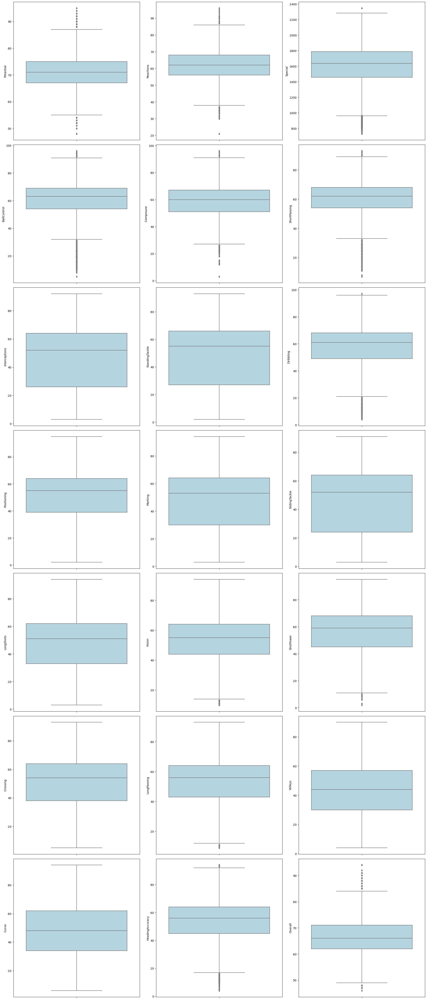

In [ ]:
# Plotting the boxplots for the features

def plots():
    num_cols = len(fifa_reduced.columns)
    num_rows = 7

    # Calculate the number of columns needed to accommodate all plots
    num_plots_per_row = math.ceil(num_cols / num_rows)

    # Create the grid of subplots
    fig, ax = plt.subplots(nrows=num_rows, ncols=num_plots_per_row, figsize=(7 * num_plots_per_row, 7 * num_rows))

    # Flatten the ax array for easy iteration
    ax = ax.flatten()

    # Plot each column in a separate subplot
    for i, col in enumerate(fifa_reduced.columns):
        sns.boxplot(y=fifa_reduced[col], ax=ax[i], color='lightblue', orient='h')
        ax[i].set_ylabel(col)

    # Remove any unused subplots
    for j in range(i + 1, len(ax)):
        fig.delaxes(ax[j])

    plt.tight_layout()
    plt.show()

plots()

This function plots() generates boxplots for each column in the DataFrame fifa_reduced. It first calculates the number of columns and rows needed for the subplots and creates a grid of subplots. Each column's data is then plotted as a horizontal boxplot using seaborn's boxplot() function, with the column name set as the y-axis label. Any unused subplots are removed to avoid empty plots. Finally, the layout is adjusted for better visualization, and the plots are displayed with plt.show().

In [ ]:
def iqr_function(colname):
    q1 = fifa_reduced[colname].quantile(0.25)
    q3 = fifa_reduced[colname].quantile(0.75)
    iqr = q3 - q1
    if iqr == 0:
        print(f'Skipping IQR for {colname} due to low variability.')
        print('\n-----------------------------------------------------------------------')
        return

    lower = q1 - 1.5 * iqr
    upper = q3 + 1.5 * iqr
    print(f'{colname}')
    print(f'Lower value of {colname} is {lower}')
    print(f'Upper value of {colname} is {upper}')
    print('\n-----------------------------------------------------------------------')

    # Replace values below the lower bound
    fifa_reduced.loc[fifa_reduced[colname] < lower, colname] = lower

    # Replace values above the upper bound
    fifa_reduced.loc[fifa_reduced[colname] > upper, colname] = upper

for col in fifa_reduced.columns:
    iqr_function(col)

Potential
Lower value of Potential is 55.0
Upper value of Potential is 87.0

-----------------------------------------------------------------------
Reactions
Lower value of Reactions is 38.0
Upper value of Reactions is 86.0

-----------------------------------------------------------------------
Special
Lower value of Special is 962.0
Upper value of Special is 2282.0

-----------------------------------------------------------------------
BallControl
Lower value of BallControl is 31.5
Upper value of BallControl is 91.5

-----------------------------------------------------------------------
Composure
Lower value of Composure is 27.0
Upper value of Composure is 91.0

-----------------------------------------------------------------------
ShortPassing
Lower value of ShortPassing is 33.0
Upper value of ShortPassing is 89.0

-----------------------------------------------------------------------
Interceptions
Lower value of Interceptions is -31.0
Upper value of Interceptions is 121.0

---

The code defines a function iqr_function that calculates the interquartile range (IQR) for a specified column in the DataFrame fifa_reduced. It first computes the 25th percentile (Q1) and 75th percentile (Q3) of the column, then calculates the IQR as the difference between Q3 and Q1. If the IQR is zero, indicating low variability, it skips the adjustment for that column. Otherwise, it calculates the lower and upper bounds using 1.5 times the IQR and replaces any values in the column that are outside these bounds with the respective lower or upper bound. The function is then applied to each column of the DataFrame.

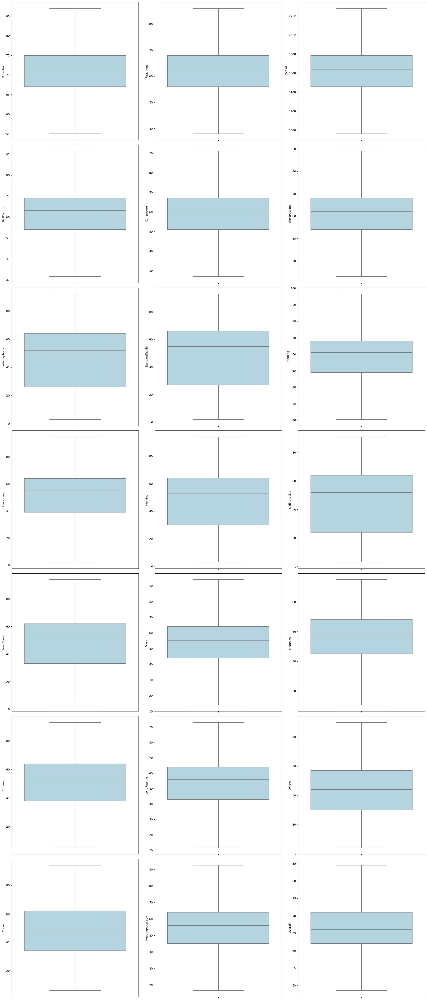

In [ ]:
# Plotting the boxplot after the removal of the outliers

plots()

This function plots() generates boxplots for each column in the DataFrame fifa_reduced after the removal of the outliers. It first calculates the number of columns and rows needed for the subplots and creates a grid of subplots. Each column's data is then plotted as a horizontal boxplot using seaborn's boxplot() function, with the column name set as the y-axis label. Any unused subplots are removed to avoid empty plots. Finally, the layout is adjusted for better visualization, and the plots are displayed with plt.show().

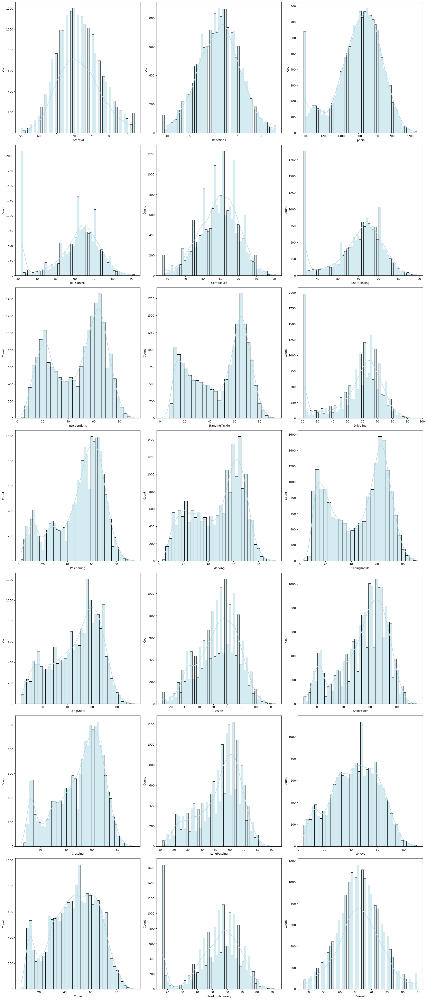

In [ ]:
def hist_plots():
    num_cols = len(fifa_reduced.columns)
    num_rows = 7

    # Calculate the number of columns needed to accommodate all plots
    num_plots_per_row = math.ceil(num_cols / num_rows)

    # Create the grid of subplots
    fig, ax = plt.subplots(nrows=num_rows, ncols=num_plots_per_row, figsize=(7 * num_plots_per_row, 7 * num_rows))

    # Flatten the ax array for easy iteration
    ax = ax.flatten()

    # Plot each column in a separate subplot
    for i, col in enumerate(fifa_reduced.columns):
        sns.histplot(fifa_reduced[col], ax=ax[i], kde=True, color='lightblue')
        ax[i].set_xlabel(col)

    # Remove any unused subplots
    for j in range(i + 1, len(ax)):
        fig.delaxes(ax[j])

    plt.tight_layout()
    plt.show()

hist_plots()

This function hist_plots() creates histograms for each column in the DataFrame fifa_reduced. It first calculates the number of columns and rows needed for the subplots and creates a grid of subplots. Each column's data is then plotted as a histogram with a kernel density estimate (KDE) using seaborn's histplot() function. The x-axis is labeled with the column name, and any unused subplots are removed to avoid displaying empty plots. Finally, the layout is adjusted for better visualization, and the plots are displayed using plt.show().

In [ ]:
# Finding the skew values of the features

skew_value=fifa_reduced.iloc[:,:21].skew()
print(skew_value)

Potential          0.228043
Reactions         -0.086956
Special           -0.588971
BallControl       -0.776430
Composure         -0.312413
ShortPassing      -0.705729
Interceptions     -0.270658
StandingTackle    -0.339471
Dribbling         -0.869913
Positioning       -0.722979
Marking           -0.365253
SlidingTackle     -0.269110
LongShots         -0.434349
Vision            -0.341667
ShotPower         -0.680977
Crossing          -0.596945
LongPassing       -0.597068
Volleys           -0.149333
Curve             -0.238864
HeadingAccuracy   -0.757505
Overall            0.021315
dtype: float64


In [ ]:
fifa_reduced

,Potential,Reactions,Special,BallControl,Composure,ShortPassing,Interceptions,StandingTackle,Dribbling,Positioning,...,SlidingTackle,LongShots,Vision,ShotPower,Crossing,LongPassing,Volleys,Curve,HeadingAccuracy,Overall
0,87,86.0,2202,91.5,91.0,89.0,22.0,28.0,96.5,94.0,...,26.0,94.0,94.0,85.0,84.0,87.0,86.0,93.0,70.0,84.5
1,87,86.0,2228,91.5,91.0,81.0,29.0,31.0,88.0,95.0,...,23.0,93.0,82.0,95.0,84.0,77.0,87.0,81.0,89.0,84.5
2,87,86.0,2143,91.5,91.0,84.0,36.0,24.0,96.0,89.0,...,33.0,82.0,87.0,80.0,79.0,78.0,84.0,88.0,62.0,84.5
3,87,86.0,1471,42.0,68.0,50.0,30.0,21.0,20.5,12.0,...,13.0,12.0,68.0,31.0,17.0,51.0,13.0,21.0,21.0,84.5
4,87,86.0,2281,91.0,88.0,89.0,61.0,58.0,86.0,87.0,...,51.0,91.0,94.0,91.0,93.0,91.0,82.0,85.0,55.0,84.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18202,65,49.0,1307,43.0,45.0,49.0,46.0,48.0,42.0,39.0,...,47.0,38.0,52.0,43.0,34.0,45.0,25.0,30.0,40.0,48.5
18203,63,40.0,1098,40.0,42.0,43.0,16.0,15.0,39.0,46.0,...,19.0,42.0,33.0,41.0,23.0,25.0,36.0,32.0,52.0,48.5
18204,67,47.0,1189,44.0,41.0,38.0,15.0,13.0,45.0,48.0,...,11.0,45.0,43.0,45.0,25.0,28.0,38.0,38.0,46.0,48.5
18205,66,38.0,1228,52.0,46.0,42.0,22.0,25.0,51.0,44.0,...,27.0,34.0,47.0,64.0,44.0,32.0,40.0,34.0,39.0,48.5


<Figure size 1200x1200 with 0 Axes>

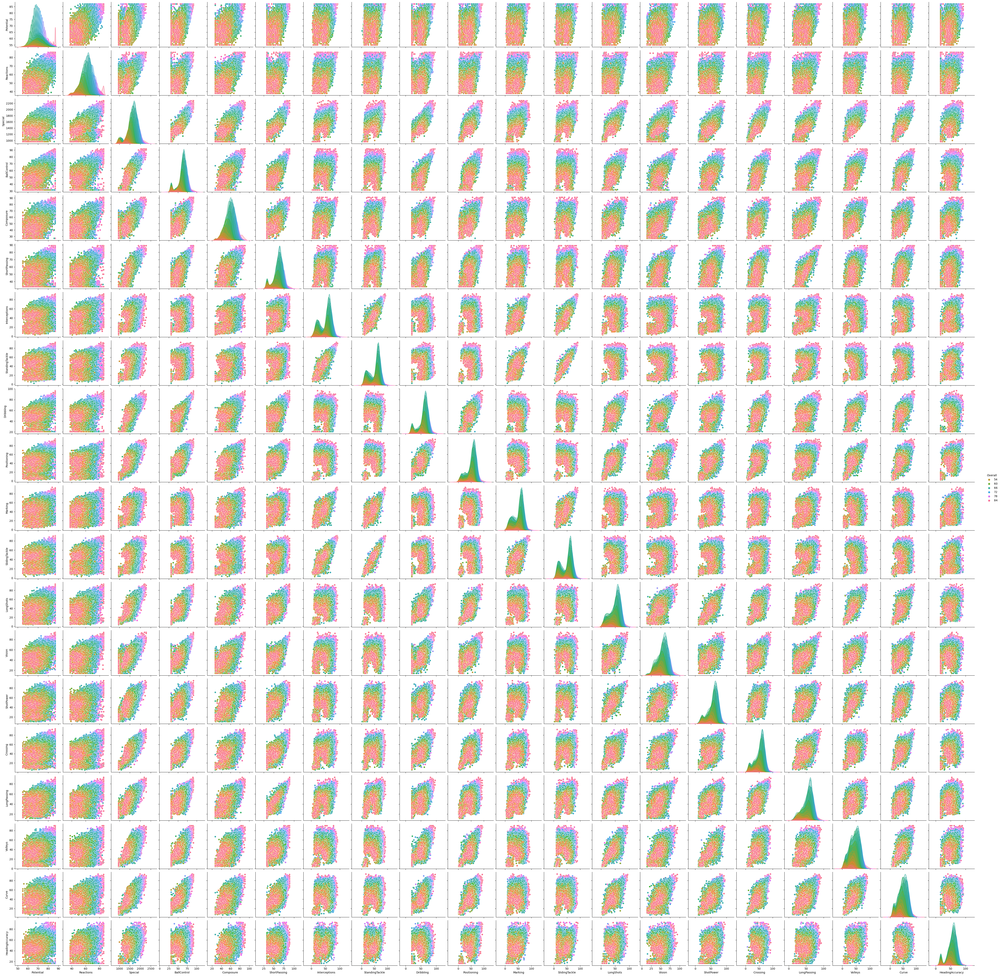

In [ ]:
# plotting the pairplot

plt.figure(figsize=(12, 12))
sns.pairplot(fifa_reduced,hue ='Overall',palette="husl")
plt.show()

The code generates pairwise scatter plots for the fifa_reduced dataset, coloring the points based on the Overall feature using the "husl" palette, and then displays the figure. This allows you to visually explore the relationships between different features and how they correlate with the overall player ratings in your FIFA dataset.

In [ ]:
# Finding the correlation between the features of the dataset

corr=fifa_reduced.corr()
print(corr)

                 Potential  Reactions   Special  BallControl  Composure  \
Potential         1.000000   0.510274  0.384674     0.398345   0.439974   
Reactions         0.510274   1.000000  0.594799     0.492218   0.690050   
Special           0.384674   0.594799  1.000000     0.908805   0.751533   
BallControl       0.398345   0.492218  0.908805     1.000000   0.697409   
Composure         0.439974   0.690050  0.751533     0.697409   1.000000   
ShortPassing      0.394479   0.515438  0.903583     0.897896   0.699785   
Interceptions     0.154568   0.337831  0.558501     0.369575   0.396506   
StandingTackle    0.143377   0.254801  0.535996     0.360555   0.350368   
Dribbling         0.329219   0.382306  0.864813     0.929990   0.597335   
Positioning       0.244199   0.385655  0.822964     0.860173   0.579701   
Marking           0.162599   0.282881  0.558372     0.396975   0.382564   
SlidingTackle     0.128994   0.227746  0.503976     0.326587   0.315982   
LongShots         0.26537

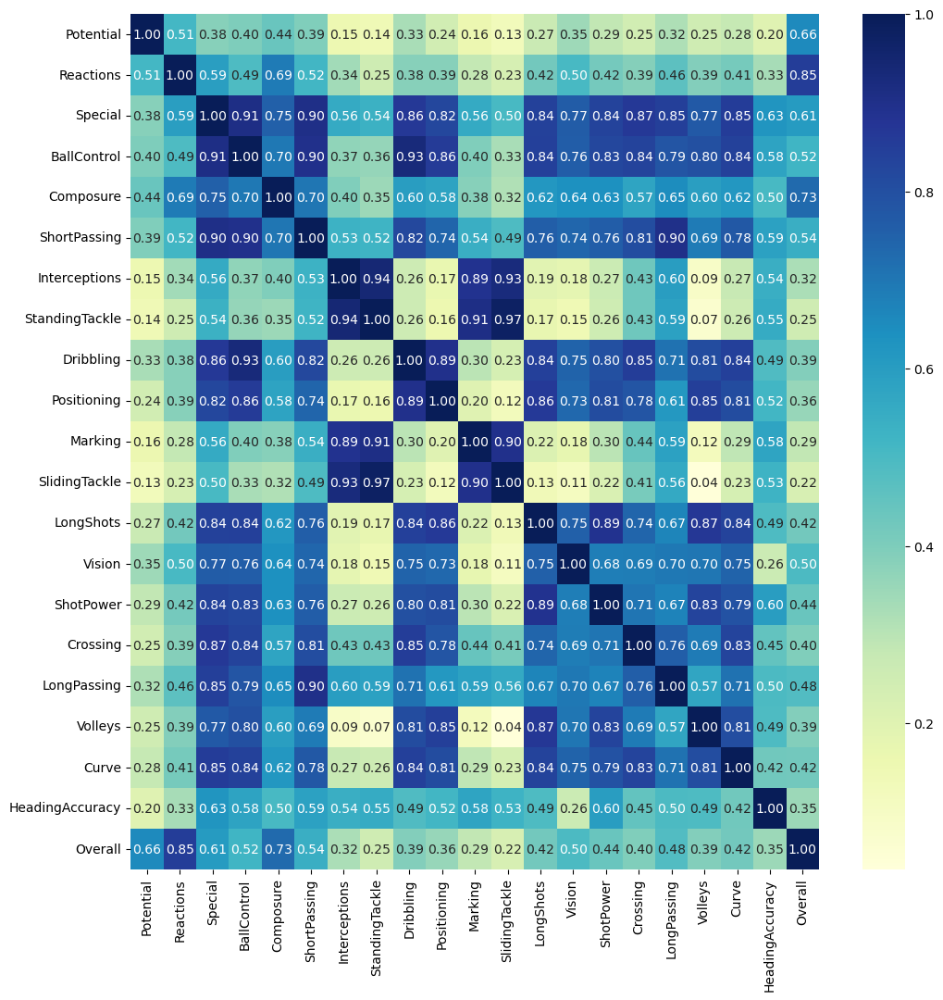

In [ ]:
plt.figure(figsize=(12, 12))
sns.heatmap(corr, cmap="YlGnBu", annot=True,fmt='0.2f')
plt.show()

This code generates a heatmap of the correlation matrix corr using Seaborn's heatmap function. The heatmap displays the correlation values between variables, with the "YlGnBu" colormap representing the strength of the correlations. The annot=True option adds the correlation values to each cell, formatted to two decimal places (fmt='0.2f'), and the plot is sized at 12x12 for clarity.

<Figure size 1200x1200 with 0 Axes>

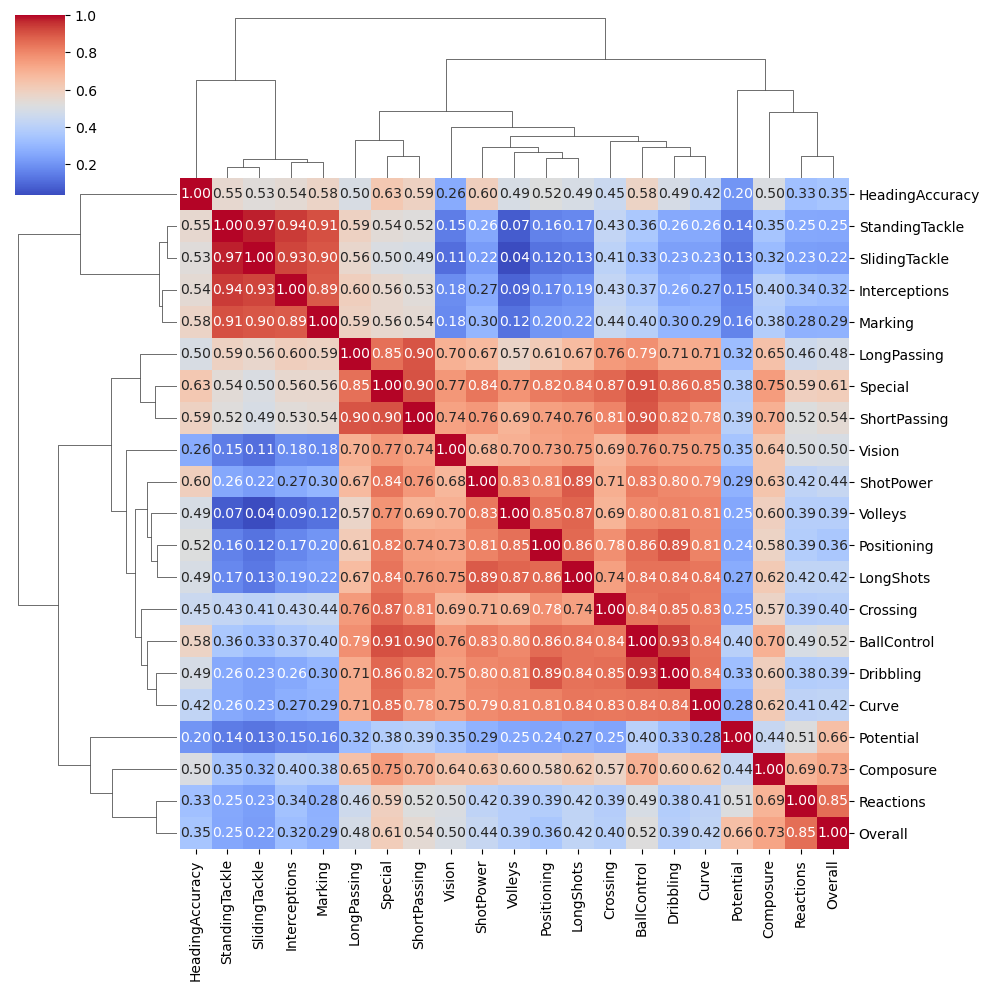

In [ ]:
plt.figure(figsize=(12, 12))
sns.clustermap(corr, annot=True, cmap="coolwarm",fmt='0.2f')
plt.show()

This code creates a clustered heatmap of the correlation matrix corr using Seaborn's clustermap function. The heatmap visualizes the pairwise correlations between variables, with the coolwarm colormap indicating the strength and direction of the correlations (positive or negative). The annot=True option displays the correlation values within the heatmap cells, formatted to two decimal places using fmt='0.2f'. The plot is shown in a 12x12 figure for better readability.

# Machine Learning Models

Regression methods are statistical techniques used to model the relationship between a dependent variable and one or more independent variables. They estimate the strength and direction of these relationships, allowing for predictions and understanding of how changes in independent variables impact the dependent variable.

## Data Splitting

In [ ]:
# Splitting the fifa_reduced dataset into fifa_data and fifa_target

fifa_data=fifa_reduced.drop(columns=['Overall'])
fifa_target=fifa_reduced['Overall']

In [ ]:
fifa_data.shape

(18207, 20)

In [ ]:
fifa_target.shape

(18207,)

## Linear Regression

Linear regression is a statistical method used to model the relationship between a dependent variable and one or more independent variables by fitting a linear equation to observed data. It estimates the parameters of the equation to minimize the difference between predicted and actual values, enabling predictions and understanding of how changes in independent variables influence the dependent variable.


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(fifa_data, fifa_target, test_size=0.2, random_state=42)


In [ ]:
# Scaling the dataset

scaler=StandardScaler()
X_train_scaled=scaler.fit_transform(X_train)
X_test_scaled=scaler.transform(X_test)


# Linear regression model

lr_model=LinearRegression()
lr_model.fit(X_train_scaled,y_train)
y_pred=lr_model.predict(X_test_scaled)

In [ ]:
# Evaluating the model

score=r2_score(y_test,y_pred)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)

# Print the evaluation metrics
print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

R-squared: 0.8505
Mean Absolute Error (MAE): 2.0150
Mean Squared Error (MSE): 6.8247
Root Mean Squared Error (RMSE): 2.6124


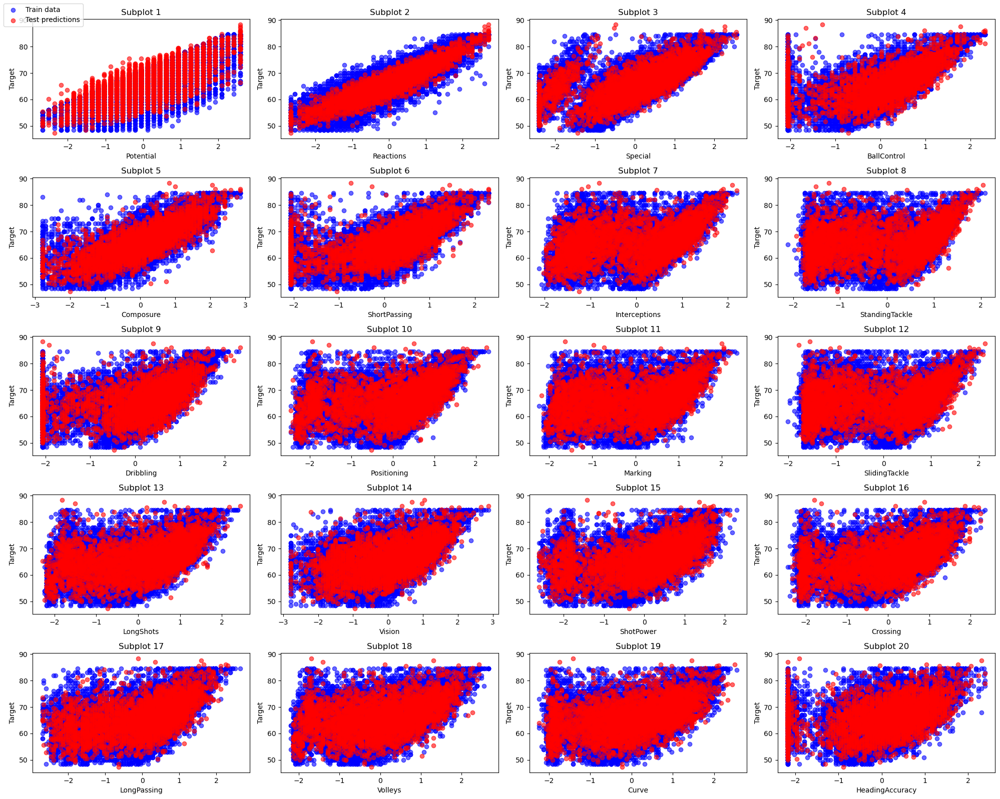

In [ ]:
# Plotting the test results

n_cols = 4  # Number of columns in the subplot grid
n_rows = 5  # Number of rows in the subplot grid

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 16))

column_names = X_train.columns

# Iterate through each feature and plot it in the corresponding subplot
for i in range(20):
    row = i // n_cols
    col = i % n_cols

    ax = axes[row, col]
    ax.scatter(X_train_scaled[:, i], y_train, color='blue', label='Train data', alpha=0.6)
    ax.scatter(X_test_scaled[:, i], y_pred, color='red', label='Test predictions', alpha=0.6)
    ax.set_xlabel(column_names[i])
    ax.set_ylabel('Target')
    ax.set_title(f'Subplot {i+1}')

# To avoid overlapping of plots, you can add padding between subplots
plt.tight_layout()

# Add a single legend for all subplots
fig.legend(['Train data', 'Test predictions'], loc='upper left')
plt.show()

This code creates a grid of scatter plots, arranged in a 5x4 layout (20 subplots in total), where each subplot visualizes the relationship between a feature (from both training and test datasets) and the target variable. The data is scaled, and the X_train_scaled and X_test_scaled arrays contain the transformed features. In each subplot, blue dots represent the training data, while red dots represent the test data predictions. The x-axis labels are assigned the column names from X_train, and the y-axis is labeled as 'Target'. The plt.tight_layout() function ensures proper spacing between subplots, and a single legend is added to the figure to avoid cluttering each subplot with individual legends.

In [ ]:
# Testing the model with new data


new_player_one = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_one)
predicted_overall = lr_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 79


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl', 'ShortPassing' etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

In [ ]:
# Using PCA
pca=PCA(n_components=20)
X_train_pca=pca.fit_transform(X_train_scaled)
X_test_pca=pca.transform(X_test_scaled)


# Model Creation

pca_model = LinearRegression()
pca_model.fit(X_train_pca, y_train)
y_pred = pca_model.predict(X_test_pca)

In [ ]:
# Evaluating the model

score=r2_score(y_test,y_pred)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)

# Print the evaluation metrics
print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

R-squared: 0.8505
Mean Absolute Error (MAE): 2.0150
Mean Squared Error (MSE): 6.8247
Root Mean Squared Error (RMSE): 2.6124


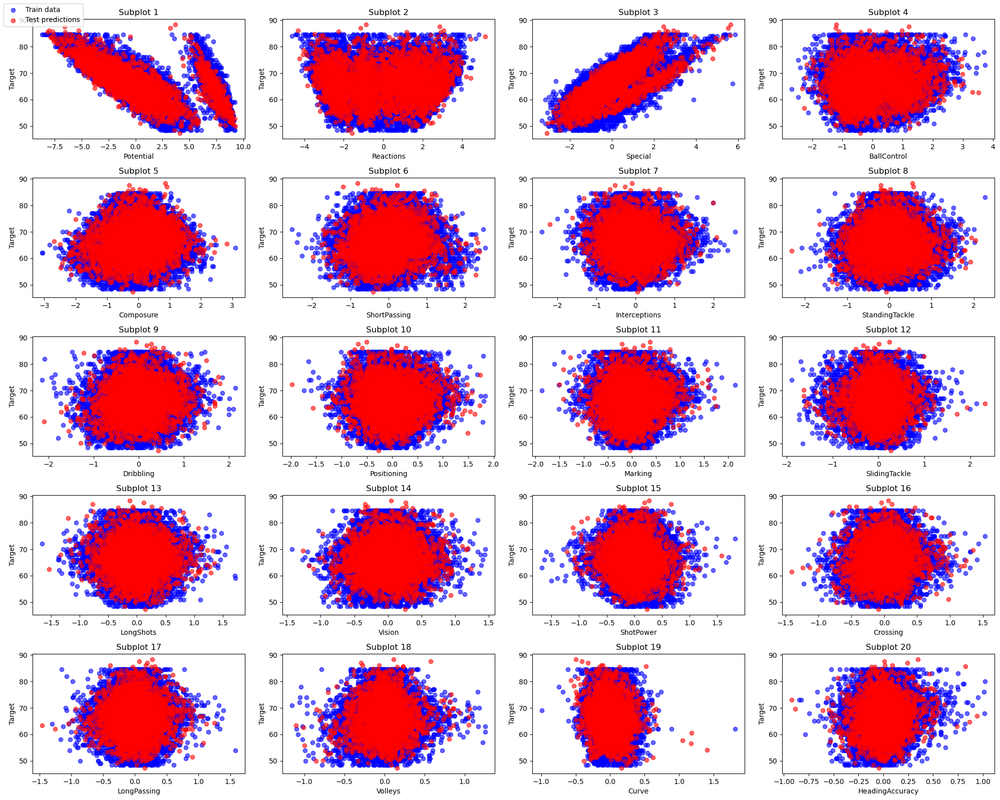

In [ ]:
# Plotting the results

n_cols = 4  # Number of columns in the subplot grid
n_rows = 5  # Number of rows in the subplot grid

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 16))

column_names = X_train.columns

# Iterate through each feature and plot it in the corresponding subplot
for i in range(20):
    row = i // n_cols
    col = i % n_cols

    ax = axes[row, col]
    ax.scatter(X_train_pca[:, i], y_train, color='blue', label='Train data', alpha=0.6)
    ax.scatter(X_test_pca[:, i], y_pred, color='red', label='Test predictions', alpha=0.6)
    ax.set_xlabel(column_names[i])
    ax.set_ylabel('Target')
    ax.set_title(f'Subplot {i+1}')

# To avoid overlapping of plots, you can add padding between subplots
plt.tight_layout()

# Add a single legend for all subplots
fig.legend(['Train data', 'Test predictions'], loc='upper left')
plt.show()

This code creates a grid of scatter plots, arranged in a 5x4 layout (20 subplots in total), where each subplot visualizes the relationship between a feature (from both training and test datasets) and the target variable. The data is scaled, and the X_train_pca and X_test_pca arrays contain the transformed features. In each subplot, blue dots represent the training data, while red dots represent the test data predictions. The x-axis labels are assigned the column names from X_train, and the y-axis is labeled as 'Target'. The plt.tight_layout() function ensures proper spacing between subplots, and a single legend is added to the figure to avoid cluttering each subplot with individual legends.

In [ ]:
# Testing the model with new data


new_player_two = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_two)
predicted_overall = pca_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 73


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl', 'ShortPassing' etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

### Linear Regression  - Hyperparameter Tuning

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(fifa_data, fifa_target, test_size=0.2, random_state=42)

In [ ]:
X_train_scaled=scaler.fit_transform(X_train)
X_test_scaled=scaler.transform(X_test)


pipeline = Pipeline([
    ('poly_features', PolynomialFeatures()),
    ('ridge', Ridge())
])

# Define the parameter grid
param_grid = {
    'poly_features__degree': [1, 2, 3],
    'ridge__alpha': [0.1, 1, 10, 100]
}

# Create the GridSearchCV object
grid_search = GridSearchCV(pipeline,param_grid, cv=5)

# Fit the model
grid_search.fit(X_train_scaled, y_train)

# Print the best parameters and the corresponding score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best cross-validation score: {grid_search.best_score_}")

Best parameters: {'poly_features__degree': 3, 'ridge__alpha': 100}
Best cross-validation score: 0.9564834544421752


In [ ]:
# Evaluate on the test set
best_model = grid_search.best_estimator_

test_score = best_model.score(X_test_scaled, y_test)
y_pred= best_model.predict(X_test_scaled)

score=r2_score(y_test,y_pred)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)


print(f"Test set score: {test_score:.4f}")

# Print the evaluation metrics
print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

Test set score: 0.953438
R-squared: 0.9534
Mean Absolute Error (MAE): 1.0251
Mean Squared Error (MSE): 2.1260
Root Mean Squared Error (RMSE): 1.4581


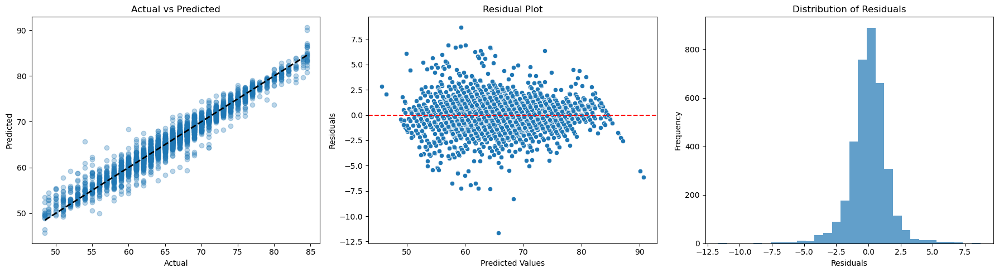

In [ ]:
residuals = y_test - y_pred

# Create a figure and a set of subplots
fig, axs = plt.subplots(1, 3, figsize=(18, 5))

# Plot 1: Actual vs Predicted
axs[0].scatter(y_test, y_pred, alpha=0.3)
axs[0].plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
axs[0].set_xlabel("Actual")
axs[0].set_ylabel("Predicted")
axs[0].set_title("Actual vs Predicted")

# Plot 2: Residual Plot
sns.scatterplot(x=y_pred, y=residuals, ax=axs[1])
axs[1].axhline(0, color='red', linestyle='--')
axs[1].set_xlabel('Predicted Values')
axs[1].set_ylabel('Residuals')
axs[1].set_title('Residual Plot')

# Plot 3: Distribution of Residuals
axs[2].hist(residuals, bins=30, alpha=0.7)
axs[2].set_xlabel("Residuals")
axs[2].set_ylabel("Frequency")
axs[2].set_title("Distribution of Residuals")

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()

This code generates a set of three diagnostic plots to evaluate the performance of Linear regression model. In the first plot, "Actual vs Predicted," the relationship between the true target values (y_test) and the model's predicted values (y_pred) is visualized, with a reference line indicating perfect predictions. The second plot, the "Residual Plot," shows the residuals (the difference between the actual and predicted values) against the predicted values, with a red horizontal line at zero to assess the pattern of errors. The third plot is a histogram that displays the distribution of the residuals to check for normality and any skewness in the model's errors. The layout is adjusted for clarity, and the plots are shown in a single figure.

In [ ]:
# Testing the model with new data


new_player_three = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_three)
predicted_overall = best_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 84


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl','ShortPassing' etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

## Random Forest Regressor

Random Forest Regressor is an ensemble learning method that combines multiple decision trees to predict a continuous numerical value. It improves accuracy and reduces overfitting by averaging predictions from various trees built on different subsets of the data.

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(fifa_data, fifa_target, test_size=0.2, random_state=42)

In [ ]:
# Model creation

rf_model=RandomForestRegressor(n_estimators=100, random_state=42)

rf_model.fit(X_train,y_train)

y_pred=rf_model.predict(X_test)

In [ ]:
# Evaluating the model

score=r2_score(y_test,y_pred)
mae=mean_absolute_error(y_test,y_pred)
mse=mean_squared_error(y_test,y_pred)
rmse = np.sqrt(mse)

print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

R-squared: 0.9472
Mean Absolute Error (MAE): 1.054653
Mean Squared Error (MSE): 2.412448
Root Mean Squared Error (RMSE): 1.5532


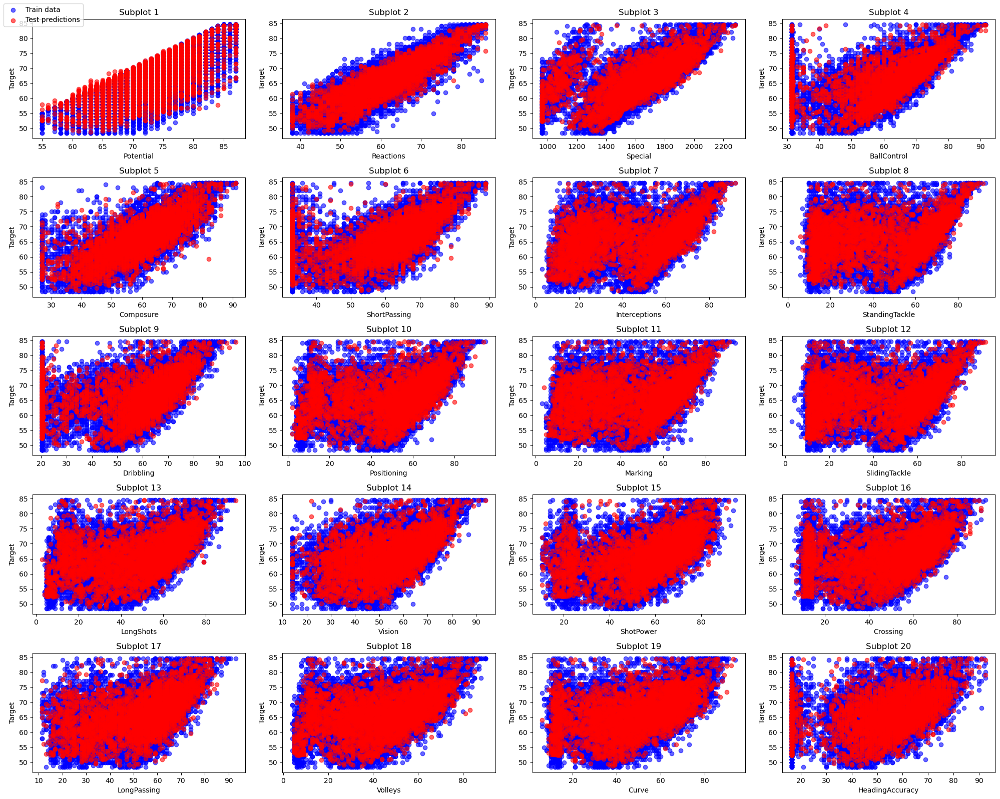

In [ ]:
# Plotting the results

n_cols = 4  # Number of columns in the subplot grid
n_rows = 5  # Number of rows in the subplot grid

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 16))

column_names = X_train.columns

# Iterate through each feature and plot it in the corresponding subplot
for i in range(20):
    row = i // n_cols
    col = i % n_cols

    ax = axes[row, col]
    ax.scatter(X_train.iloc[:, i], y_train, color='blue', label='Train data', alpha=0.6)
    ax.scatter(X_test.iloc[:, i], y_pred, color='red', label='Test predictions', alpha=0.6)
    ax.set_xlabel(column_names[i])
    ax.set_ylabel('Target')
    ax.set_title(f'Subplot {i+1}')

# To avoid overlapping of plots, you can add padding between subplots
plt.tight_layout()

# Add a single legend for all subplots
fig.legend(['Train data', 'Test predictions'], loc='upper left')
plt.show()

This code creates a grid of scatter plots, arranged in a 5x4 layout (20 subplots in total), where each subplot visualizes the relationship between a feature (from both training and test datasets) and the target variable. The data is scaled, and the X_train and X_test arrays contain the transformed features. In each subplot, blue dots represent the training data, while red dots represent the test data predictions. The x-axis labels are assigned the column names from X_train, and the y-axis is labeled as 'Target'. The plt.tight_layout() function ensures proper spacing between subplots, and a single legend is added to the figure to avoid cluttering each subplot with individual legends.

In [ ]:
# Testing the model with new data


new_player_four = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_four)
predicted_overall = rf_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 53


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl','ShortPassing' etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

### Random Forest Regressor - Hyperparameter Tuning

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(fifa_data, fifa_target, test_size=0.2, random_state=42)

In [ ]:
rf_model=RandomForestRegressor()

param_grid = {
    'n_estimators': [100, 200, 300],
    'max_features': ['auto', 'sqrt', 'log2']
}

# Set up the grid search
grid_search = GridSearchCV(estimator=rf_model, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)

# Fit the model
grid_search.fit(X_train, y_train)

# Get the best parameters
best_params = grid_search.best_params_

print("Best parameters found: ", best_params)
print(f"Best cross-validation score: {grid_search.best_score_}")

Fitting 5 folds for each of 9 candidates, totalling 45 fits
Best parameters found:  {'max_features': 'sqrt', 'n_estimators': 300}
Best cross-validation score: 0.9563942639051204


In [ ]:
# Evaluate on the test set
best_model = grid_search.best_estimator_

test_score = best_model.score(X_test, y_test)
y_pred= best_model.predict(X_test)

score=r2_score(y_test,y_pred)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)


print(f"Test set score: {test_score:.4f}")

# Print the evaluation metrics
print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

Test set score: 0.952491
R-squared: 0.9525
Mean Absolute Error (MAE): 1.0153
Mean Squared Error (MSE): 2.1693
Root Mean Squared Error (RMSE): 1.4728


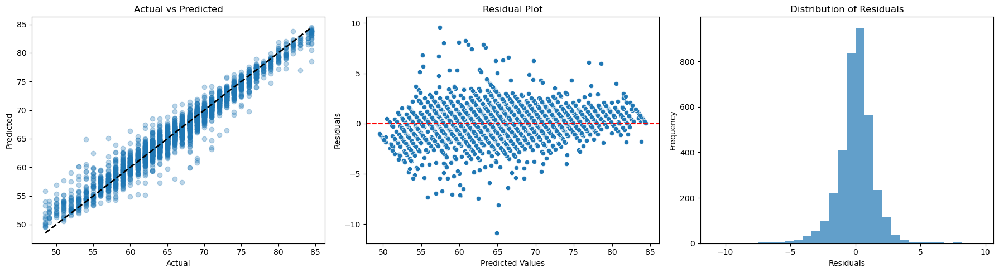

In [ ]:
residuals = y_test - y_pred

# Create a figure and a set of subplots
fig, axs = plt.subplots(1, 3, figsize=(18, 5))

# Plot 1: Actual vs Predicted
axs[0].scatter(y_test, y_pred, alpha=0.3)
axs[0].plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
axs[0].set_xlabel("Actual")
axs[0].set_ylabel("Predicted")
axs[0].set_title("Actual vs Predicted")

# Plot 2: Residual Plot
sns.scatterplot(x=y_pred, y=residuals, ax=axs[1])
axs[1].axhline(0, color='red', linestyle='--')
axs[1].set_xlabel('Predicted Values')
axs[1].set_ylabel('Residuals')
axs[1].set_title('Residual Plot')

# Plot 3: Distribution of Residuals
axs[2].hist(residuals, bins=30, alpha=0.7)
axs[2].set_xlabel("Residuals")
axs[2].set_ylabel("Frequency")
axs[2].set_title("Distribution of Residuals")

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()

This code generates a set of three diagnostic plots to evaluate the performance of Random Forest regressor model. In the first plot, "Actual vs Predicted," the relationship between the true target values (y_test) and the model's predicted values (y_pred) is visualized, with a reference line indicating perfect predictions. The second plot, the "Residual Plot," shows the residuals (the difference between the actual and predicted values) against the predicted values, with a red horizontal line at zero to assess the pattern of errors. The third plot is a histogram that displays the distribution of the residuals to check for normality and any skewness in the model's errors. The layout is adjusted for clarity, and the plots are shown in a single figure.

In [ ]:
# Testing the model with new data


new_player_five = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_five)
predicted_overall = best_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 54


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl', 'ShortPassing' etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

## Support Vector Regression (SVR)

Support Vector Regression (SVR) is an extension of Support Vector Machines (SVM) for regression tasks. It aims to find the best fit line (or hyperplane) that maximizes the margin between the line and data points, allowing for a specified error tolerance.



In [ ]:
X_train, X_test, y_train, y_test = train_test_split(fifa_data, fifa_target, test_size=0.2, random_state=42)

In [ ]:
# Model Creation

svr_model=SVR()
X_train_scaled=scaler.fit_transform(X_train)
X_test_scaled=scaler.transform(X_test)

svr_model.fit(X_train_scaled,y_train)
y_pred=svr_model.predict(X_test_scaled)

In [ ]:
# Evaluating the model

score=r2_score(y_test,y_pred)
mae=mean_absolute_error(y_test,y_pred)
mse=mean_squared_error(y_test,y_pred)
rmse = np.sqrt(mse)

print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

R-squared: 0.9535
Mean Absolute Error (MAE): 1.006069
Mean Squared Error (MSE): 2.123310
Root Mean Squared Error (RMSE): 1.4572


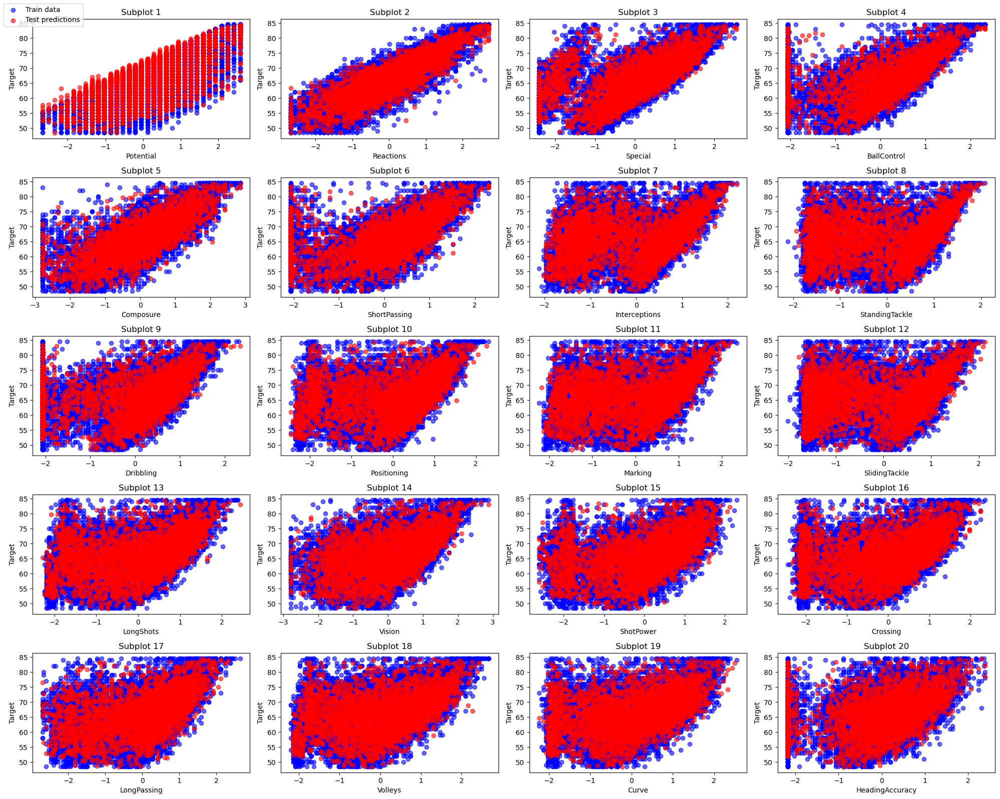

In [ ]:
# Plotting the results

n_cols = 4  # Number of columns in the subplot grid
n_rows = 5  # Number of rows in the subplot grid

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 16))

column_names = X_train.columns

# Iterate through each feature and plot it in the corresponding subplot
for i in range(20):
    row = i // n_cols
    col = i % n_cols

    ax = axes[row, col]
    ax.scatter(X_train_scaled[:, i], y_train, color='blue', label='Train data', alpha=0.6)
    ax.scatter(X_test_scaled[:, i], y_pred, color='red', label='Test predictions', alpha=0.6)
    ax.set_xlabel(column_names[i])
    ax.set_ylabel('Target')
    ax.set_title(f'Subplot {i+1}')

# To avoid overlapping of plots, you can add padding between subplots
plt.tight_layout()

# Add a single legend for all subplots
fig.legend(['Train data', 'Test predictions'], loc='upper left')
plt.show()

This code creates a grid of scatter plots, arranged in a 5x4 layout (20 subplots in total), where each subplot visualizes the relationship between a feature (from both training and test datasets) and the target variable. The data is scaled, and the X_train_scaled and X_test_scaled arrays contain the transformed features. In each subplot, blue dots represent the training data, while red dots represent the test data predictions. The x-axis labels are assigned the column names from X_train, and the y-axis is labeled as 'Target'. The plt.tight_layout() function ensures proper spacing between subplots, and a single legend is added to the figure to avoid cluttering each subplot with individual legends.

In [ ]:
# Testing the model with new data


new_player_six = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_six)
predicted_overall = svr_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 83


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl','ShortPassing'  etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

### SVR - Hyperparameter Tuning

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(fifa_data, fifa_target, test_size=0.2, random_state=42)

In [ ]:
# Create the SVR model
svr = SVR()
X_train_scaled=scaler.fit_transform(X_train)
X_test_scaled=scaler.transform(X_test)

param_grid = {
    'C': [1, 10, 100],
    'epsilon': [0.1, 0.5,1]

}

In [ ]:

# Define the grid search
grid_search = GridSearchCV(estimator=svr, param_grid=param_grid, cv=5, verbose=2, n_jobs=-1)


grid_search.fit(X_train_scaled, y_train)

best_params = grid_search.best_params_

print("Best Parameters:", best_params)
print(f"Best cross-validation score: {grid_search.best_score_}")

Fitting 5 folds for each of 9 candidates, totalling 45 fits
Best Parameters: {'C': 10, 'epsilon': 0.1}
Best cross-validation score: 0.9648892856410637


In [ ]:
# Evaluate on the test set
best_model = grid_search.best_estimator_

test_score = best_model.score(X_test_scaled, y_test)
y_pred= best_model.predict(X_test_scaled)

score=r2_score(y_test,y_pred)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)


print(f"Test set score: {test_score:.4f}")

# Print the evaluation metrics
print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

Test set score: 0.960265
R-squared: 0.9603
Mean Absolute Error (MAE): 0.9081
Mean Squared Error (MSE): 1.8143
Root Mean Squared Error (RMSE): 1.3470


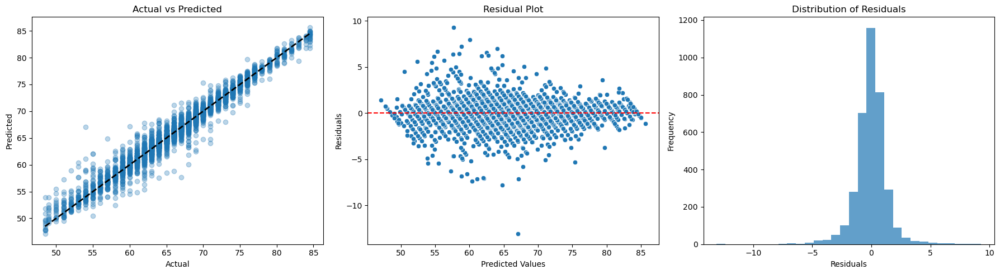

In [ ]:
residuals = y_test - y_pred

# Create a figure and a set of subplots
fig, axs = plt.subplots(1, 3, figsize=(18, 5))

# Plot 1: Actual vs Predicted
axs[0].scatter(y_test, y_pred, alpha=0.3)
axs[0].plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
axs[0].set_xlabel("Actual")
axs[0].set_ylabel("Predicted")
axs[0].set_title("Actual vs Predicted")

# Plot 2: Residual Plot
sns.scatterplot(x=y_pred, y=residuals, ax=axs[1])
axs[1].axhline(0, color='red', linestyle='--')
axs[1].set_xlabel('Predicted Values')
axs[1].set_ylabel('Residuals')
axs[1].set_title('Residual Plot')

# Plot 3: Distribution of Residuals
axs[2].hist(residuals, bins=30, alpha=0.7)
axs[2].set_xlabel("Residuals")
axs[2].set_ylabel("Frequency")
axs[2].set_title("Distribution of Residuals")

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()

This code generates a set of three diagnostic plots to evaluate the performance of Support Vector  regression model. In the first plot, "Actual vs Predicted," the relationship between the true target values (y_test) and the model's predicted values (y_pred) is visualized, with a reference line indicating perfect predictions. The second plot, the "Residual Plot," shows the residuals (the difference between the actual and predicted values) against the predicted values, with a red horizontal line at zero to assess the pattern of errors. The third plot is a histogram that displays the distribution of the residuals to check for normality and any skewness in the model's errors. The layout is adjusted for clarity, and the plots are shown in a single figure.

In [ ]:
# Testing the model with new data


new_player_seven = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_seven)
predicted_overall = best_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 84


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl', 'ShortPassing' etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

## Gradient Boosting Regressor

Gradient Boosting Regressor is an ensemble method that builds multiple weak models sequentially. Each new model aims to correct the errors of the previous ones by minimizing a loss function using gradient descent. This iterative process results in a strong predictive model capable of handling complex patterns and achieving high accuracy.

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(fifa_data, fifa_target, test_size=0.2, random_state=42)

In [ ]:
# Model Creation

gbr_model=GradientBoostingRegressor()

gbr_model.fit(X_train,y_train)

y_pred=gbr_model.predict(X_test)

In [ ]:
# Evaluating the model

score=r2_score(y_test,y_pred)
mae=mean_absolute_error(y_test,y_pred)
mse=mean_squared_error(y_test,y_pred)
rmse = np.sqrt(mse)

print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

R-squared: 0.9286
Mean Absolute Error (MAE): 1.309118
Mean Squared Error (MSE): 3.258595
Root Mean Squared Error (RMSE): 1.8052


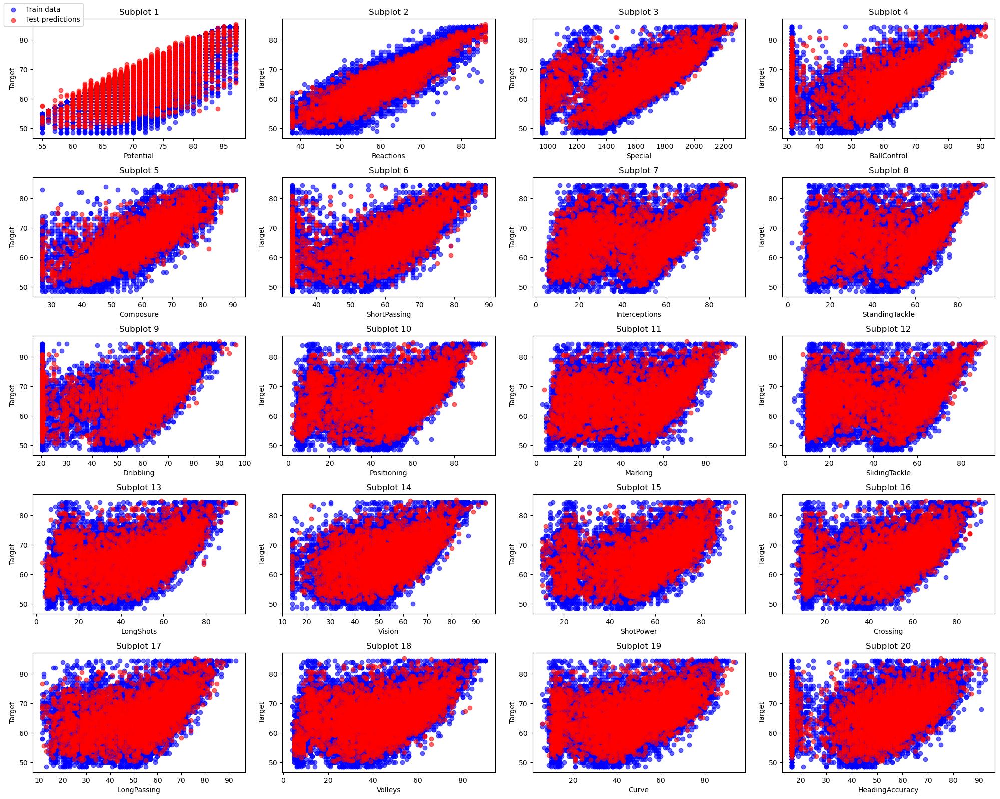

In [ ]:
# Plotting the results

n_cols = 4  # Number of columns in the subplot grid
n_rows = 5  # Number of rows in the subplot grid

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 16))

column_names = X_train.columns

# Iterate through each feature and plot it in the corresponding subplot
for i in range(20):
    row = i // n_cols
    col = i % n_cols

    ax = axes[row, col]
    ax.scatter(X_train.iloc[:, i], y_train, color='blue', label='Train data', alpha=0.6)
    ax.scatter(X_test.iloc[:, i], y_pred, color='red', label='Test predictions', alpha=0.6)
    ax.set_xlabel(column_names[i])
    ax.set_ylabel('Target')
    ax.set_title(f'Subplot {i+1}')

# To avoid overlapping of plots, you can add padding between subplots
plt.tight_layout()

# Add a single legend for all subplots
fig.legend(['Train data', 'Test predictions'], loc='upper left')
plt.show()

This code creates a grid of scatter plots, arranged in a 5x4 layout (20 subplots in total), where each subplot visualizes the relationship between a feature (from both training and test datasets) and the target variable. The data is scaled, and the X_train and X_test arrays contain the transformed features. In each subplot, blue dots represent the training data, while red dots represent the test data predictions. The x-axis labels are assigned the column names from X_train, and the y-axis is labeled as 'Target'. The plt.tight_layout() function ensures proper spacing between subplots, and a single legend is added to the figure to avoid cluttering each subplot with individual legends.

In [ ]:
# Testing the model with new data


new_player_eight = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_eight)
predicted_overall = gbr_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 51


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl','ShortPassing' etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

### Gradient Boosting Regressor - Hyperparameter Tuning

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(fifa_data, fifa_target, test_size=0.2, random_state=42)

In [ ]:
# Create the GBR model
gbr = GradientBoostingRegressor()


param_grid = {
    'n_estimators': [100, 300, 500],
    'learning_rate': [0.01, 0.1, 1]
}

In [ ]:
# Define the grid search
grid_search = GridSearchCV(estimator=gbr, param_grid=param_grid, cv=5, verbose=2, n_jobs=-1)

# Fit the grid search
grid_search.fit(X_train, y_train)

# Get the best parameters
best_params = grid_search.best_params_


print("Best Parameters:", best_params)
print(f"Best cross-validation score: {grid_search.best_score_}")

Fitting 5 folds for each of 9 candidates, totalling 45 fits
Best Parameters: {'learning_rate': 0.1, 'n_estimators': 500}
Best cross-validation score: 0.9527692985014896


In [ ]:
# Evaluate on the test set
best_model = grid_search.best_estimator_

test_score = best_model.score(X_test, y_test)
y_pred= best_model.predict(X_test)

score=r2_score(y_test,y_pred)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)


print(f"Test set score: {test_score:.4f}")

# Print the evaluation metrics
print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

Test set score: 0.946976
R-squared: 0.9470
Mean Absolute Error (MAE): 1.1113
Mean Squared Error (MSE): 2.4211
Root Mean Squared Error (RMSE): 1.5560


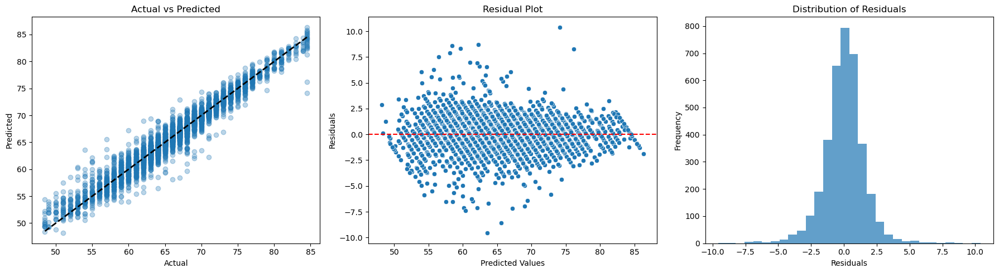

In [ ]:
residuals = y_test - y_pred

# Create a figure and a set of subplots
fig, axs = plt.subplots(1, 3, figsize=(18, 5))

# Plot 1: Actual vs Predicted
axs[0].scatter(y_test, y_pred, alpha=0.3)
axs[0].plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
axs[0].set_xlabel("Actual")
axs[0].set_ylabel("Predicted")
axs[0].set_title("Actual vs Predicted")

# Plot 2: Residual Plot
sns.scatterplot(x=y_pred, y=residuals, ax=axs[1])
axs[1].axhline(0, color='red', linestyle='--')
axs[1].set_xlabel('Predicted Values')
axs[1].set_ylabel('Residuals')
axs[1].set_title('Residual Plot')

# Plot 3: Distribution of Residuals
axs[2].hist(residuals, bins=30, alpha=0.7)
axs[2].set_xlabel("Residuals")
axs[2].set_ylabel("Frequency")
axs[2].set_title("Distribution of Residuals")

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()

This code generates a set of three diagnostic plots to evaluate the performance Gradient Boosting Regressor regression model. In the first plot, "Actual vs Predicted," the relationship between the true target values (y_test) and the model's predicted values (y_pred) is visualized, with a reference line indicating perfect predictions. The second plot, the "Residual Plot," shows the residuals (the difference between the actual and predicted values) against the predicted values, with a red horizontal line at zero to assess the pattern of errors. The third plot is a histogram that displays the distribution of the residuals to check for normality and any skewness in the model's errors. The layout is adjusted for clarity, and the plots are shown in a single figure.

In [ ]:
# Testing the model with new data


new_player_nine = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_nine)
predicted_overall = best_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 51


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl','ShortPassing' etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

## Adaboost

AdaBoost is an ensemble learning method that combines multiple weak classifiers to create a strong classifier. It assigns higher weights to misclassified data points in each iteration, focusing subsequent models on correcting errors. This adaptive process improves overall performance by sequentially building upon previous models.

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(fifa_data, fifa_target, test_size=0.2, random_state=42)

In [ ]:
# Model creation

reg_model=AdaBoostRegressor()

reg_model.fit(X_train,y_train)
y_pred=reg_model.predict(X_test)

In [ ]:
# Evaluating the model

score=r2_score(y_test,y_pred)
mae=mean_absolute_error(y_test,y_pred)
mse=mean_squared_error(y_test,y_pred)
rmse = np.sqrt(mse)

print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:4f}')
print(f'Mean Squared Error (MSE): {mse:4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

R-squared: 0.8291
Mean Absolute Error (MAE): 2.270088
Mean Squared Error (MSE): 7.801337
Root Mean Squared Error (RMSE): 2.7931


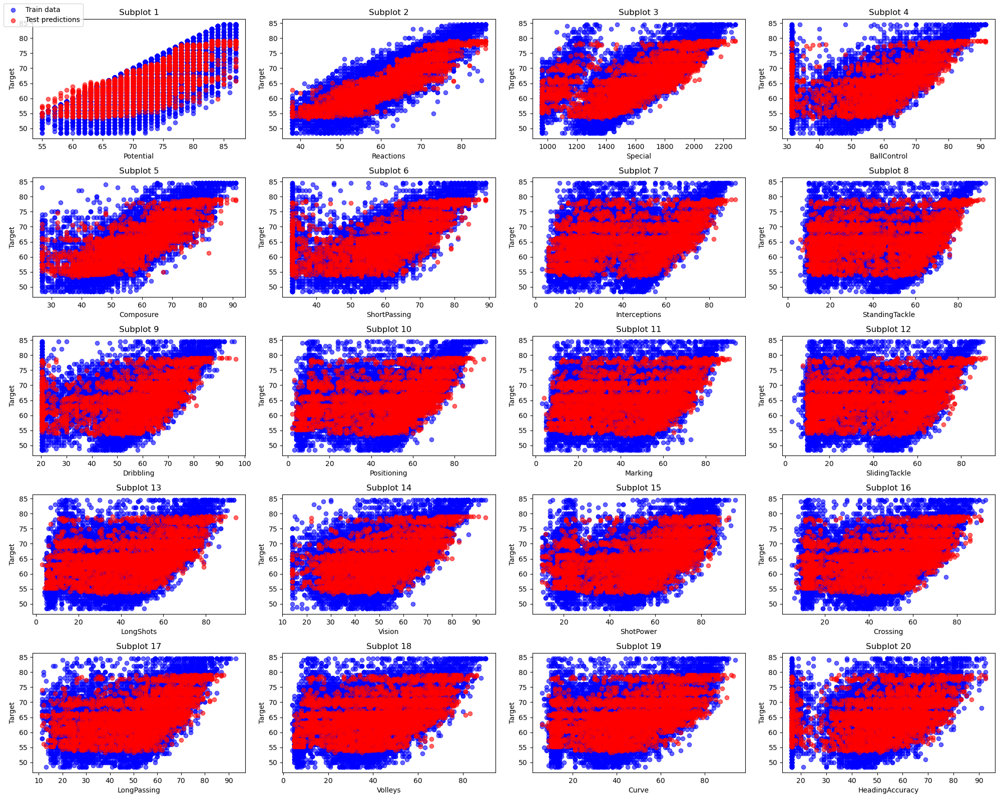

In [ ]:
# Plotting the results

n_cols = 4  # Number of columns in the subplot grid
n_rows = 5  # Number of rows in the subplot grid

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 16))

column_names = X_train.columns

# Iterate through each feature and plot it in the corresponding subplot
for i in range(20):
    row = i // n_cols
    col = i % n_cols

    ax = axes[row, col]
    ax.scatter(X_train.iloc[:, i], y_train, color='blue', label='Train data', alpha=0.6)
    ax.scatter(X_test.iloc[:, i], y_pred, color='red', label='Test predictions', alpha=0.6)
    ax.set_xlabel(column_names[i])
    ax.set_ylabel('Target')
    ax.set_title(f'Subplot {i+1}')

# To avoid overlapping of plots, you can add padding between subplots
plt.tight_layout()

# Add a single legend for all subplots
fig.legend(['Train data', 'Test predictions'], loc='upper left')
plt.show()

This code creates a grid of scatter plots, arranged in a 5x4 layout (20 subplots in total), where each subplot visualizes the relationship between a feature (from both training and test datasets) and the target variable. The data is scaled, and the X_train and X_test arrays contain the transformed features. In each subplot, blue dots represent the training data, while red dots represent the test data predictions. The x-axis labels are assigned the column names from X_train, and the y-axis is labeled as 'Target'. The plt.tight_layout() function ensures proper spacing between subplots, and a single legend is added to the figure to avoid cluttering each subplot with individual legends.

In [ ]:
# Testing the model with new data


new_player_ten = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_ten)
predicted_overall = reg_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 57


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl','ShortPassing' etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

### Adaboost - Hyperparameter Tuning

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(fifa_data, fifa_target, test_size=0.2, random_state=42)

In [ ]:

base_estimator = DecisionTreeRegressor()
ada = AdaBoostRegressor(base_estimator=base_estimator)

param_grid = {
    'n_estimators': [100, 300, 500],
    'learning_rate': [0.01, 0.1, 1.0]

}

In [ ]:
grid_search = GridSearchCV(estimator=ada, param_grid=param_grid, cv=5, verbose=2, n_jobs=-1)

# Fit the grid search
grid_search.fit(X_train, y_train)

# Get the best parameters
best_params = grid_search.best_params_


print("Best Parameters:", best_params)
print(f"Best cross-validation score: {grid_search.best_score_}")

Fitting 5 folds for each of 9 candidates, totalling 45 fits
Best Parameters: {'learning_rate': 1.0, 'n_estimators': 500}
Best cross-validation score: 0.9559094192468919


In [ ]:
# Evaluate on the test set
best_model = grid_search.best_estimator_

test_score = best_model.score(X_test, y_test)
y_pred= best_model.predict(X_test)

score=r2_score(y_test,y_pred)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)


print(f"Test set score: {test_score:.4f}")

# Print the evaluation metrics
print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

Test set score: 0.948659
R-squared: 0.9487
Mean Absolute Error (MAE): 0.9345
Mean Squared Error (MSE): 2.3442
Root Mean Squared Error (RMSE): 1.5311


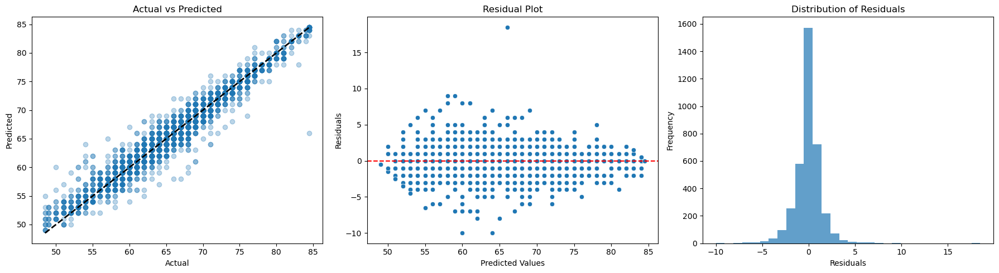

In [ ]:
residuals = y_test - y_pred

# Create a figure and a set of subplots
fig, axs = plt.subplots(1, 3, figsize=(18, 5))

# Plot 1: Actual vs Predicted
axs[0].scatter(y_test, y_pred, alpha=0.3)
axs[0].plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
axs[0].set_xlabel("Actual")
axs[0].set_ylabel("Predicted")
axs[0].set_title("Actual vs Predicted")

# Plot 2: Residual Plot
sns.scatterplot(x=y_pred, y=residuals, ax=axs[1])
axs[1].axhline(0, color='red', linestyle='--')
axs[1].set_xlabel('Predicted Values')
axs[1].set_ylabel('Residuals')
axs[1].set_title('Residual Plot')

# Plot 3: Distribution of Residuals
axs[2].hist(residuals, bins=30, alpha=0.7)
axs[2].set_xlabel("Residuals")
axs[2].set_ylabel("Frequency")
axs[2].set_title("Distribution of Residuals")

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()

This code generates a set of three diagnostic plots to evaluate the performance of Adaboost model. In the first plot, "Actual vs Predicted," the relationship between the true target values (y_test) and the model's predicted values (y_pred) is visualized, with a reference line indicating perfect predictions. The second plot, the "Residual Plot," shows the residuals (the difference between the actual and predicted values) against the predicted values, with a red horizontal line at zero to assess the pattern of errors. The third plot is a histogram that displays the distribution of the residuals to check for normality and any skewness in the model's errors. The layout is adjusted for clarity, and the plots are shown in a single figure.

In [ ]:
# Testing the model with new data


new_player_eleven = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_eleven)
predicted_overall = best_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 53


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl', 'ShortPassing' etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

## MLP Regressor

MLPRegressor is a neural network model used for regression tasks. It consists of multiple layers of interconnected neurons, where each layer processes the input and passes the result to the next. By learning complex patterns in the data, MLPRegressor can predict continuous numerical values.

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(fifa_data, fifa_target, test_size=0.2, random_state=42)

In [ ]:
# Model creation

mlp_model=MLPRegressor()

X_train_scaled=scaler.fit_transform(X_train)
X_test_scaled=scaler.transform(X_test)

mlp_model.fit(X_train_scaled,y_train)
y_pred=mlp_model.predict(X_test_scaled)

In [ ]:
# Evaluation of model

score=r2_score(y_test,y_pred)
mae=mean_absolute_error(y_test,y_pred)
mse=mean_squared_error(y_test,y_pred)
rmse = np.sqrt(mse)

print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

R-squared: 0.9546
Mean Absolute Error (MAE): 1.004870
Mean Squared Error (MSE): 2.072613
Root Mean Squared Error (RMSE): 1.4397


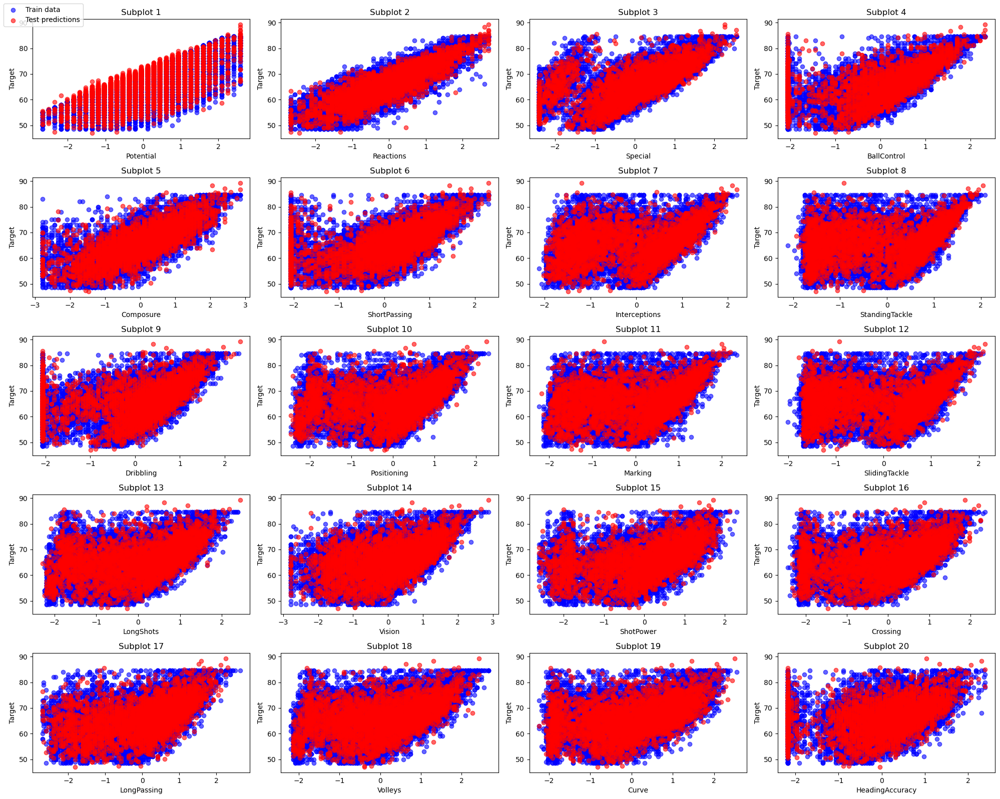

In [ ]:
# Plotting the results

n_cols = 4  # Number of columns in the subplot grid
n_rows = 5  # Number of rows in the subplot grid

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 16))

column_names = X_train.columns

# Iterate through each feature and plot it in the corresponding subplot
for i in range(20):
    row = i // n_cols
    col = i % n_cols

    ax = axes[row, col]
    ax.scatter(X_train_scaled[:, i], y_train, color='blue', label='Train data', alpha=0.6)
    ax.scatter(X_test_scaled[:, i], y_pred, color='red', label='Test predictions', alpha=0.6)
    ax.set_xlabel(column_names[i])
    ax.set_ylabel('Target')
    ax.set_title(f'Subplot {i+1}')

# To avoid overlapping of plots, you can add padding between subplots
plt.tight_layout()

# Add a single legend for all subplots
fig.legend(['Train data', 'Test predictions'], loc='upper left')
plt.show()

This code creates a grid of scatter plots, arranged in a 5x4 layout (20 subplots in total), where each subplot visualizes the relationship between a feature (from both training and test datasets) and the target variable. The data is scaled, and the X_train_scaled and X_test_scaled arrays contain the transformed features. In each subplot, blue dots represent the training data, while red dots represent the test data predictions. The x-axis labels are assigned the column names from X_train, and the y-axis is labeled as 'Target'. The plt.tight_layout() function ensures proper spacing between subplots, and a single legend is added to the figure to avoid cluttering each subplot with individual legends.

In [ ]:
# Testing the model with new data


new_player_twelve = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_twelve)
predicted_overall = mlp_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 84


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl', 'ShortPassing' etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

### MLP Regressor - Hyperparameter Tuning

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(fifa_data, fifa_target, test_size=0.2, random_state=42)

In [ ]:
mlp = MLPRegressor()


param_grid = {
    'hidden_layer_sizes': [(100,), (50, 50), (100, 50)],
    'alpha': [0.001, 0.01, 0.1]

}

In [ ]:
# Define the grid search
grid_search = GridSearchCV(estimator=mlp, param_grid=param_grid, cv=5, verbose=2, n_jobs=-1)

# Fit the grid search
grid_search.fit(X_train_scaled, y_train)

# Get the best parameters
best_params = grid_search.best_params_

print("Best Parameters:", best_params)
print(f"Best cross-validation score: {grid_search.best_score_}")

Fitting 5 folds for each of 9 candidates, totalling 45 fits
Best Parameters: {'alpha': 0.001, 'hidden_layer_sizes': (100, 50)}
Best cross-validation score: 0.964565051780979


In [ ]:
# Evaluate on the test set
best_model = grid_search.best_estimator_

test_score = best_model.score(X_test_scaled, y_test)
y_pred= best_model.predict(X_test_scaled)

score=r2_score(y_test,y_pred)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)


print(f"Test set score: {test_score:.4f}")

# Print the evaluation metrics
print(f'R-squared: {score:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')

Test set score: 0.956697
R-squared: 0.9567
Mean Absolute Error (MAE): 0.9519
Mean Squared Error (MSE): 1.9772
Root Mean Squared Error (RMSE): 1.4061


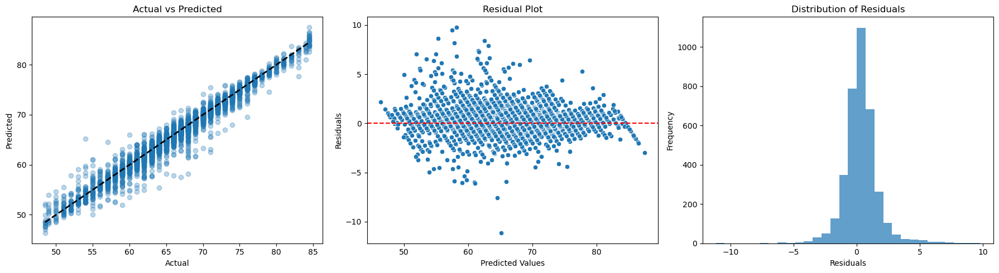

In [ ]:
residuals = y_test - y_pred

# Create a figure and a set of subplots
fig, axs = plt.subplots(1, 3, figsize=(18, 5))

# Plot 1: Actual vs Predicted
axs[0].scatter(y_test, y_pred, alpha=0.3)
axs[0].plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
axs[0].set_xlabel("Actual")
axs[0].set_ylabel("Predicted")
axs[0].set_title("Actual vs Predicted")

# Plot 2: Residual Plot
sns.scatterplot(x=y_pred, y=residuals, ax=axs[1])
axs[1].axhline(0, color='red', linestyle='--')
axs[1].set_xlabel('Predicted Values')
axs[1].set_ylabel('Residuals')
axs[1].set_title('Residual Plot')

# Plot 3: Distribution of Residuals
axs[2].hist(residuals, bins=30, alpha=0.7)
axs[2].set_xlabel("Residuals")
axs[2].set_ylabel("Frequency")
axs[2].set_title("Distribution of Residuals")

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()

This code generates a set of three diagnostic plots to evaluate the performance of MLP  regressor model. In the first plot, "Actual vs Predicted," the relationship between the true target values (y_test) and the model's predicted values (y_pred) is visualized, with a reference line indicating perfect predictions. The second plot, the "Residual Plot," shows the residuals (the difference between the actual and predicted values) against the predicted values, with a red horizontal line at zero to assess the pattern of errors. The third plot is a histogram that displays the distribution of the residuals to check for normality and any skewness in the model's errors. The layout is adjusted for clarity, and the plots are shown in a single figure.

In [ ]:
# Testing the model with new data


new_player_thirteen = pd.DataFrame({'Potential': [90],'Reactions':[85], 'Special': [2000], 'BallControl': [88], 'Composure': [89],
                           'ShortPassing': [85],'Interceptions': [82],'StandingTackle': [80], 'Dribbling': [90],
                           'Positioning': [90], 'Marking': [70],'SlidingTackle': [72],'LongShots': [82],'Vision': [80],
                           'ShotPower': [83], 'Crossing': [81], 'LongPassing':[80],'Volleys': [82], 'Curve': [80],
                           'HeadingAccuracy': [80]})

new_player_scaled=scaler.transform(new_player_thirteen)
predicted_overall = best_model.predict(new_player_scaled)
print(f'Predicted Overall Rating: {round(predicted_overall[0])}')

Predicted Overall Rating: 86


This code predicts the overall rating of a new soccer player based on their attributes. It first creates a pandas DataFrame containing various features such as 'Potential', 'BallControl', 'ShortPassing' etc. The player's data is then scaled using a pre-fitted scaler to match the training data's scale. This scaled data is passed to a pre-trained machine learning model, which predicts the player's overall rating. Finally, the predicted rating is rounded and printed to the console.

## Result

Linear Regression produced a solid performance, with a predicted rating of 79 initially. After hyperparameter tuning, its performance significantly improved to 84, showing that with the right tuning, linear regression can be a strong model for this dataset.

Support Vector Regression (SVR) and MLP Regressor emerged as the top-performing models, both yielding predicted ratings of around 83-84 range initially and 84-86 after hyperparameter tuning. This suggests that these models effectively capture the underlying relationships in the dataset, providing robust and accurate predictions.

Random Forest Regressor had moderate performance, predicting ratings of 53 initially and 54 after tuning. The overall performance of Random Forest was weaker compared to SVR and MLP, indicating it may not be the most suitable model for this dataset.

Gradient Boosting Regressor consistently predicted ratings of 51 range, both before and after tuning. This indicates that the model might not be able to capture the necessary patterns in the dataset to improve its predictions.

AdaBoost initially predicted a rating of 57, but after tuning, its performance decreased to 53. This drop suggests that the hyperparameter tuning process may have overfitted the model, leading to reduced generalization ability.

## Limitations

The dataset contains many irrelevant data  that do not contribute to predicting player ratings. It also includes numerous missing values. Additionally, most features are affected by outliers.

## Conclusion

SVR, MLP Regressor, and Linear Regression emerged as the top models for predicting FIFA player ratings, especially after hyperparameter tuning, where they converged on a high predicted rating of 84. These models demonstrated strong predictive power and consistency. In contrast, models like Random Forest, Gradient Boosting, and AdaBoost performed less effectively, with tuning having minimal or even negative impacts on their predictions.

## Future work

Enrich the Dataset:
Add More Data: If possible, gather more data, such as additional player statistics or historical performance data, which could help improve the model’s predictive accuracy.
External Features: Incorporate external data such as team performance, coaching staff details, or even market value to enrich your feature set.

Hyperparameter Tuning:
Grid Search with More Extensive Search Space: Expand the search space for your hyperparameters. For example, test a wider range of values for the number of estimators, learning rates, or regularization parameters.

Neural Network Architecture Optimization (For MLP):
Deeper Architectures: Experiment with deeper neural network architectures (more hidden layers and neurons) to capture more complex relationships in the data.